# **DESCRIPCIÓN DEL PROBLEMA**

El **Fondo Cósmico de Microondas (CMB)** es una radiación remanente del Big Bang que proporciona una de las evidencias más sólidas sobre el origen y evolución del universo. Este fondo de radiación presenta pequeñas fluctuaciones de temperatura que contienen información clave sobre la distribución inicial de materia y las condiciones físicas del universo primitivo.

En este **proyecto se busca** aplicar una red neuronal generativa adversaria convolucional (DCGAN) para **generar imágenes sintéticas del CMB** a partir de un conjunto limitado de observaciones reales de tres años de datos del Wilkinson Microwave Anisotropy Probe o **WMAP** es una sonda de la NASA cuya misión fue estudiar el cielo y medir las diferencias de temperatura.

El **objetivo principal** no es solo replicar visualmente estas estructuras, sino **demostrar el potencial de la inteligencia artificial como herramienta para la simulación y exploración científica**, especialmente en contextos donde los datos reales son escasos, costosos o difíciles de obtener.

A través del entrenamiento de este modelo, se espera obtener representaciones que respeten las propiedades estadísticas y estructurales del CMB, permitiendo **su uso en tareas como:**

- Validación de modelos cosmológicos con datos sintéticos.
- Simulación de distintos escenarios de formación del universo temprano.


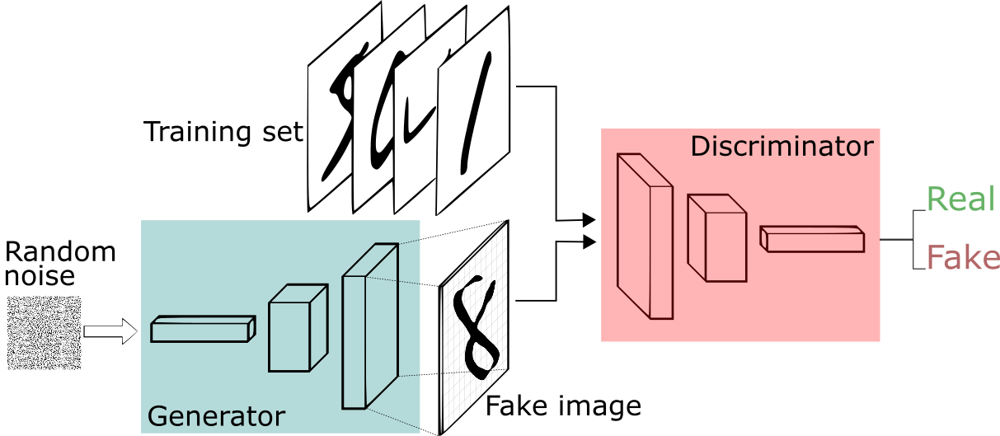

### **¿Qué es una DCGAN?**

Una **DCGAN** (Deep Convolutional Generative Adversarial Network, o Red Generativa Antagónica Convolucional Profunda) es un tipo de modelo de aprendizaje profundo que combina redes neuronales convolucionales (CNNs) con el marco de las Redes Generativas Antagónicas (GANs). Fue introducida en el artículo *"Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks"* (Radford et al., 2015). Una DCGAN se utiliza para generar datos sintéticos, como imágenes, que se asemejan a un conjunto de datos real. En el contexto del notebook, **la DCGAN se emplea para generar imágenes sintéticas que imitan los mapas de fluctuaciones de temperatura del Fondo Cósmico de Microondas (CMB) obtenidos de los datos de la misión WMAP de NASA.**

#### **Componentes principales de una DCGAN**
1. **Generador (Generator)**:
   - Toma un vector de ruido aleatorio como entrada
   - Utiliza capas convolucionales transpuestas (`Conv2DTranspose`) para transformar este vector en una imagen sintética (en este caso, mapas de 180x180 píxeles en RGB).
   - Su objetivo es generar imágenes que sean indistinguibles de las imágenes reales del dataset.

2. **Discriminador (Discriminator)**:
   - Es una red convolucional que clasifica imágenes como "reales" (del dataset) o "falsas" (generadas por el generador).
   - Toma imágenes de entrada (reales o sintéticas) y produce una probabilidad (entre 0 y 1) de que la imagen sea real.

3. **Entrenamiento antagónico**:
   - El generador y el discriminador se entrenan simultáneamente en un juego de adversarios:
     - El generador intenta "engañar" al discriminador generando imágenes más realistas.
     - El discriminador intenta mejorar su capacidad para distinguir imágenes reales de las falsas.
   - Este proceso se basa en optimizar una función de pérdida que enfrenta a ambos modelos (típicamente, la pérdida de entropía cruzada binaria).

4. **Características específicas de una DCGAN**:
   - Usa capas convolucionales en lugar de capas densas (como en las GANs originales) para capturar mejor las características espaciales de las imágenes.
   - Incluye técnicas como **BatchNormalization** para estabilizar el entrenamiento, **LeakyReLU** como activación en el discriminador, y **tanh** o **sigmoid** en el generador.
   - Diseñada para imágenes, lo que la hace ideal para generar mapas visuales como los del CMB.



#**Importación de Datos**

In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
brsdincer_cosmic_microwave_background_nasa_path = kagglehub.dataset_download('brsdincer/cosmic-microwave-background-nasa')

print('Data source import complete.')


Data source import complete.


# PACKAGES AND LIBRARIES

In [ ]:
#GENERAL
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import random
import time
#PATH PROCESS
import os
import os.path
from pathlib import Path
import glob
#IMAGE PROCESS
from PIL import Image
from IPython.display import HTML
from base64 import b64encode
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
import imageio
from IPython.display import Image
import matplotlib.image as mpimg
from skimage.transform import resize
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
import zipfile
from io import BytesIO
from nibabel import FileHolder
from nibabel.analyze import AnalyzeImage
import PIL
from IPython import display
#SCALER & TRANSFORMATION
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
#ACCURACY CONTROL
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, roc_auc_score, roc_curve
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
#OPTIMIZER
from keras.optimizers import RMSprop,Adam,Optimizer,Optimizer, SGD
#MODEL LAYERS
from tensorflow.keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D, BatchNormalization,MaxPooling2D,BatchNormalization,\
                        Permute, TimeDistributed, Bidirectional,GRU, SimpleRNN,\
LSTM, GlobalAveragePooling2D, SeparableConv2D, ZeroPadding2D, Convolution2D, ZeroPadding2D,Reshape, Conv2DTranspose, LeakyReLU,\
ConvLSTM2D,Conv3D
from keras import models
from keras import layers
import tensorflow as tf
from keras.applications import VGG16,VGG19,inception_v3
from keras import backend as K
from keras.utils import plot_model
from keras.datasets import mnist
import keras
#SKLEARN CLASSIFIER
from xgboost import XGBClassifier, XGBRegressor
from lightgbm import LGBMClassifier, LGBMRegressor
!pip install catboost
from catboost import CatBoostClassifier, CatBoostRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import ElasticNetCV
#IGNORING WARNINGS
from warnings import filterwarnings
filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning)
filterwarnings("ignore", category=UserWarning)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 25.0 MB/s eta 0:00:00


# DATA EXPORT AND TRANSFORMATION

#### MAIN PATH

In [ ]:
First_Year_Microwave = "/kaggle/input/cosmic-microwave-background-nasa/Cosmic Microwave Background/Wmap.mp4"
Third_Year_Microwave = "/kaggle/input/cosmic-microwave-background-nasa/Cosmic Microwave Background/wmap_third_year.mp4"
Fifth_Year_Microwave = "/kaggle/input/cosmic-microwave-background-nasa/Cosmic Microwave Background/wmap_fifth_year.mp4"

Microwave_List = [First_Year_Microwave,Third_Year_Microwave,Fifth_Year_Microwave]

Ver videos

Rutas de acceso a los archivos de video descargados con el dataset.
Cada archivo corresponde a un análisis de diferentes años de observación del fondo cósmico de microondas, realizados por el satélite WMAP. Estas rutas apuntan directamente a los archivos descargados y se almacenan en una lista para facilitar su uso posterior, por ejemplo, si quisiéramos mostrar los mapas en una animación o reproducir los videos uno por uno.

#### TRANSFORMATION

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("brsdincer/cosmic-microwave-background-nasa")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/cosmic-microwave-background-nasa


De los videos del fondo cósmico de microondas se guardan en una lista frame por frame.

In [ ]:
Microwave_IMG_List = []

for file_path in Microwave_List:
    Microwave_Video = file_path

    Video_Caption = cv2.VideoCapture(Microwave_Video)

    while Video_Caption.isOpened():

        _,frame = Video_Caption.read()

        if _ != True:
            break

        if Video_Caption.isOpened():
            Transformation_IMG = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
            Resize_IMG = cv2.resize(Transformation_IMG,(180,180))
            Microwave_IMG_List.append(Resize_IMG)

    Video_Caption.release()

In [ ]:
print(Microwave_IMG_List[0].shape)

(180, 180, 3)


Extraer frames (imágenes) de los tres videos del fondo cósmico de microondas, convertirlos a formato RGB, redimensionarlos a 180x180 píxeles, y almacenarlos en una lista para su posterior análisis o visualización

In [ ]:
print(len(Microwave_IMG_List))

2244


Mientras que el total de imágenes que existen en los videos son de 2244

In [ ]:
print("TOTAL SHAPE: ", str(len(Microwave_IMG_List)) + " " + str(Microwave_IMG_List[0].shape))

TOTAL SHAPE:  2244 (180, 180, 3)


In [ ]:
print(np.shape(np.array(Microwave_IMG_List)))

(2244, 180, 180, 3)


# VISION

Esta sección contiene el código para visualizar imágenes. El propósito es inspeccionar visualmente las imágenes para evaluar su calidad, estructura y similitud con los mapas reales del CMB. Es un paso exploratorio para entender cómo se ven los mapas del CMB antes de entrenar o usar la DCGAN.

#### GENERAL

In [ ]:
def video_to_html(video_path, width=320):
    mp4 = open(video_path, 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return f"""
    <video width="{width}" controls>
        <source src="{data_url}" type="video/mp4">
    </video>
    """

html_videos = ''.join([video_to_html(v) for v in Microwave_List])

HTML(html_videos)

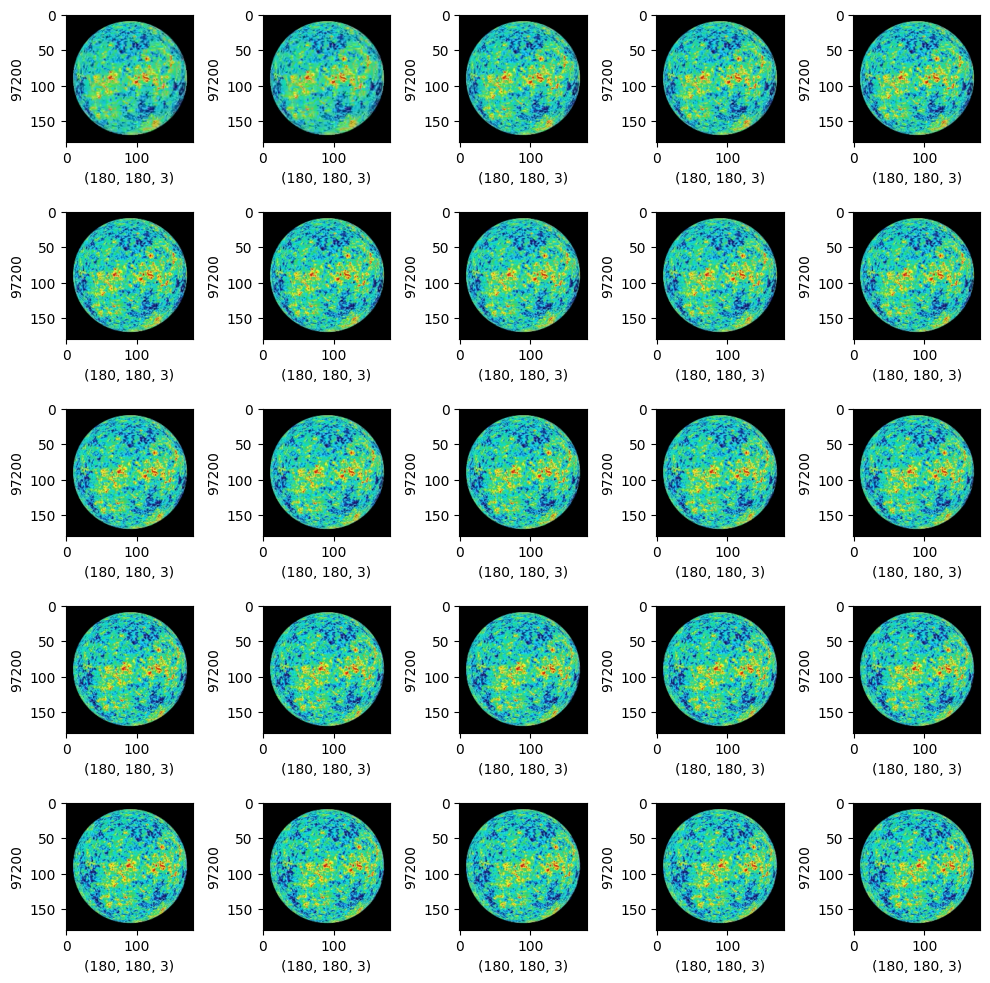

In [ ]:
figure,axis = plt.subplots(5,5,figsize=(10,10))

for indexing,operations in enumerate(axis.flat):

    Picking_Image = Microwave_IMG_List[indexing]

    operations.set_xlabel(Picking_Image.shape)
    operations.set_ylabel(Picking_Image.size)
    operations.imshow(Picking_Image)

plt.tight_layout()
plt.show()

Este frame representa una sección temprana del video. Se observan claramente las anisotropías térmicas, fundamentales para entender cómo se formaron las primeras estructuras del universo.

Se elige el elemento 22 de la lista de imágenes.

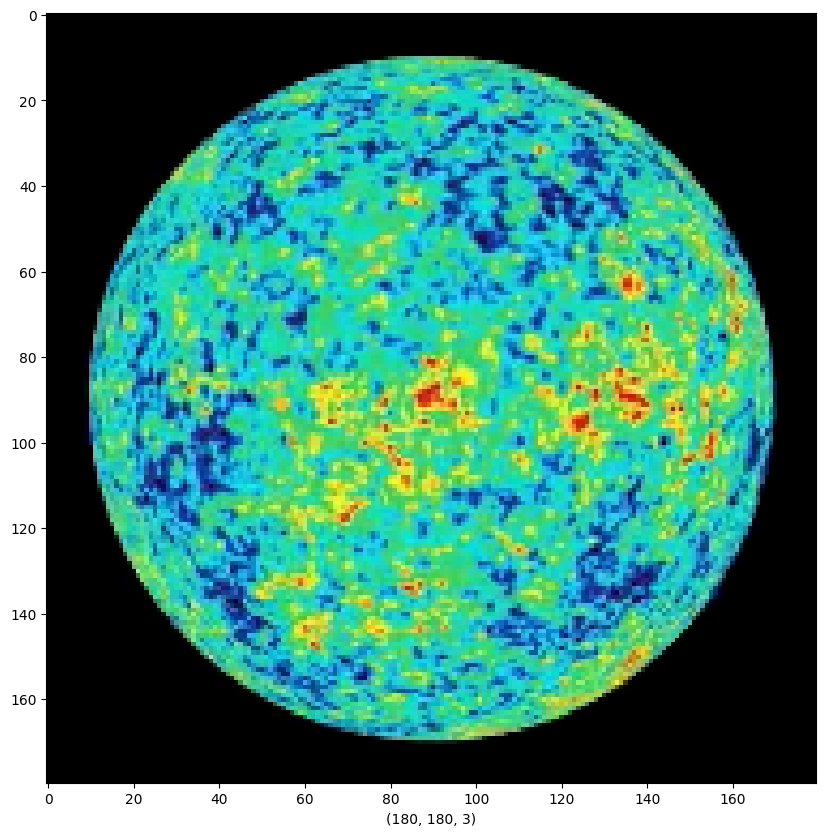

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

plt.xlabel(Picking_Image.shape)
plt.imshow(Picking_Image)

Este frame ilustra una región donde pueden aparecer artefactos o saturación de señal. Esto puede deberse al plano galáctico, donde la emisión de la Vía Láctea interfiere con la medición del CMB.

Se elige el elemento 2000 de la lista de imágenes.

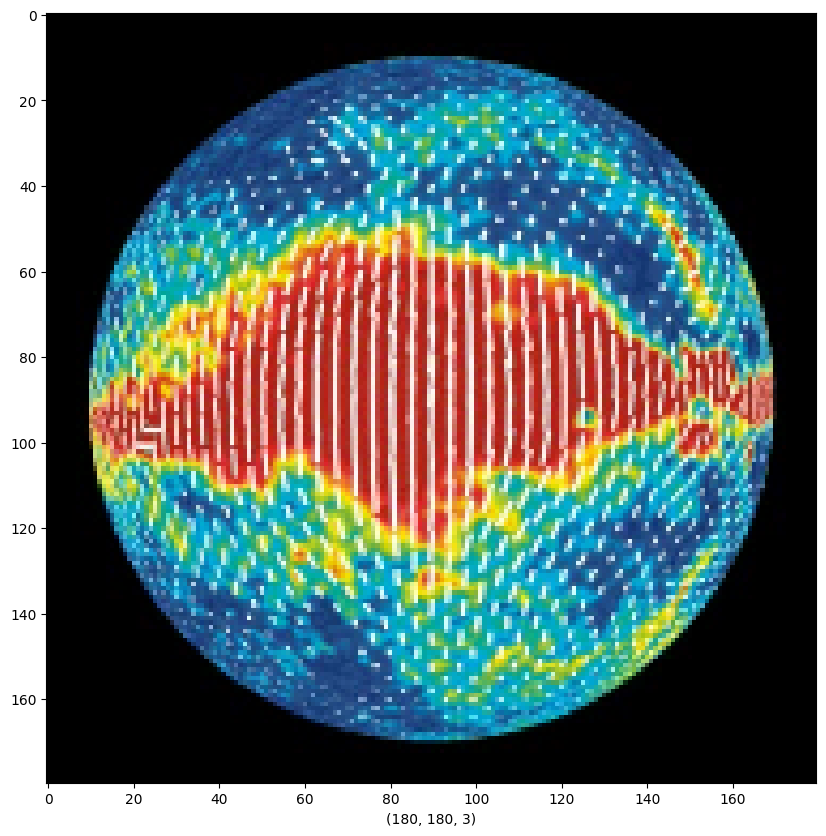

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[2000]

plt.xlabel(Picking_Image.shape)
plt.imshow(Picking_Image)

Aquí vemos el plano de la galaxia, una región donde la emisión térmica de polvo y gas interestelar contamina las observaciones del CMB. Este tipo de interferencia debe filtrarse para obtener un análisis limpio del universo primitivo.

Se elige el elemento 1000 de la lista de imágenes.

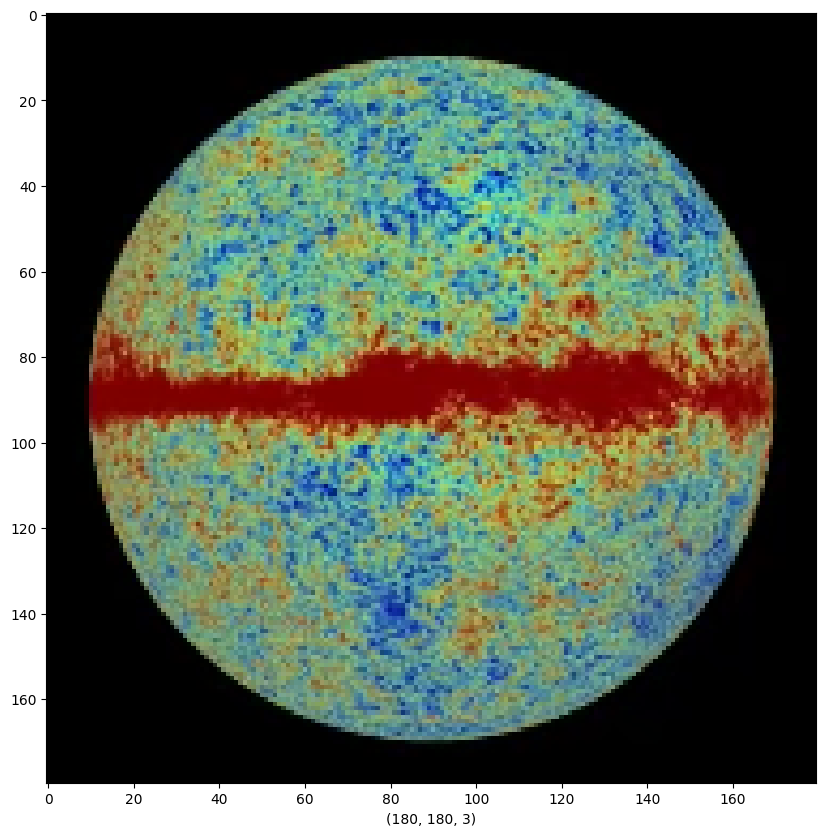

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[1000]

plt.xlabel(Picking_Image.shape)
plt.imshow(Picking_Image)

#### SPECIAL FORMATS

Hemos visualizado únicamente el **canal rojo** de tres frames seleccionados. Esta técnica nos permite analizar con más claridad la intensidad de señal térmica del fondo cósmico. A la izquierda vemos una imagen limpia, al centro una con artefactos visuales que dificultan el análisis, y a la derecha el plano galáctico, cuya fuerte emisión puede interferir con el estudio del CMB. Trabajar con canales individuales nos ayuda a detectar y eventualmente filtrar estas anomalías.

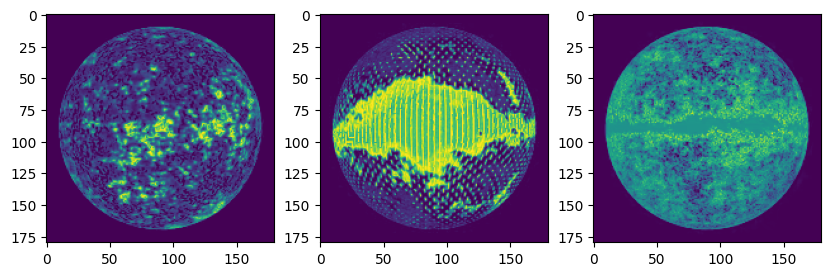

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))

Picking_Image_One = Microwave_IMG_List[22][:,:,0]
Picking_Image_Two = Microwave_IMG_List[2000][:,:,0]
Picking_Image_Three = Microwave_IMG_List[1000][:,:,0]

axis[0].imshow(Picking_Image_One)
axis[1].imshow(Picking_Image_Two)
axis[2].imshow(Picking_Image_Three)

Ahora visualizamos el **canal verde** de tres imágenes del dataset del fondo cósmico. Al igual que con el canal rojo, esto nos permite analizar con mayor claridad estructuras térmicas y artefactos. En la primera imagen se ven bien las anisotropías del universo temprano, en la segunda detectamos distorsiones, y en la tercera destaca fuertemente la interferencia de la Vía Láctea. Comparar canales permite identificar qué tipo de ruido afecta más a cada componente del color.

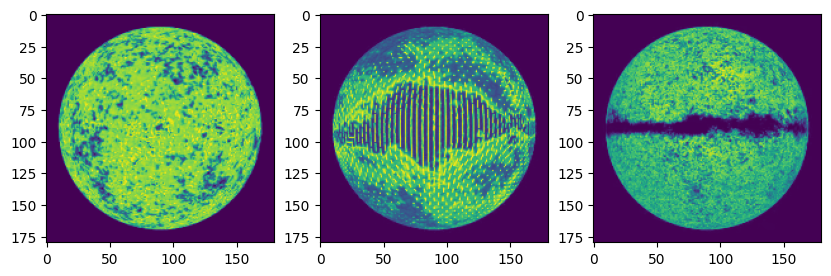

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))

Picking_Image_One = Microwave_IMG_List[22][:,:,1]
Picking_Image_Two = Microwave_IMG_List[2000][:,:,1]
Picking_Image_Three = Microwave_IMG_List[1000][:,:,1]

axis[0].imshow(Picking_Image_One)
axis[1].imshow(Picking_Image_Two)
axis[2].imshow(Picking_Image_Three)

Aquí visualizamos el **canal azul** de tres imágenes representativas. El primero muestra una señal limpia del fondo cósmico. El segundo contiene artefactos de distorsión, probablemente generados por errores en la adquisición o compresión del video. Y el tercero evidencia con mucha claridad la emisión del plano galáctico.

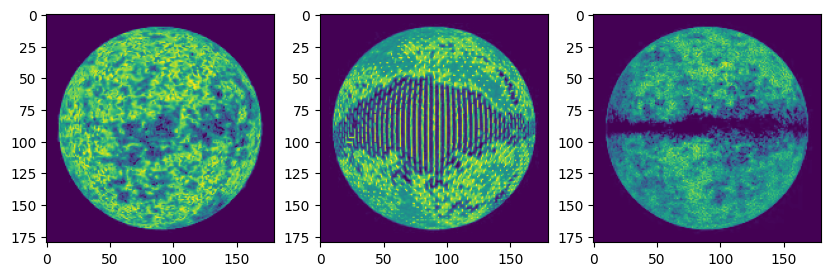

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))

Picking_Image_One = Microwave_IMG_List[22][:,:,2]
Picking_Image_Two = Microwave_IMG_List[2000][:,:,2]
Picking_Image_Three = Microwave_IMG_List[1000][:,:,2]

axis[0].imshow(Picking_Image_One)
axis[1].imshow(Picking_Image_Two)
axis[2].imshow(Picking_Image_Three)

A continuación se muestran estas tres imágenes con distintos filtros, cada uno mostrando características importantes para distinguir cada imagen.

Al comparar los tres canales (rojo, verde y azul), observamos que ciertas interferencias, como la Vía Láctea, se intensifican más en algunos canales que en otros. Esto puede guiar el preprocesamiento de datos.

Se aplicó una escala de color térmica usando cmap="hot", que ayuda a visualizar más claramente las diferencias de intensidad térmica en el fondo cósmico. Las zonas más cálidas (con mayor energía) aparecen en colores brillantes, mientras que las más frías están en tonos oscuros. Esta técnica es muy útil para resaltar anisotropías, detectar interferencias como artefactos de video, y ubicar emisiones intensas del plano galáctico.

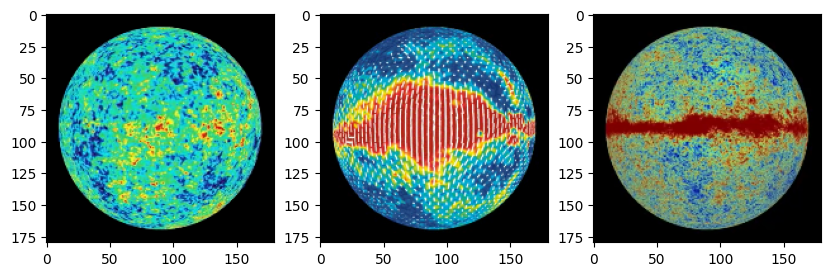

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))

Picking_Image_One = Microwave_IMG_List[22]
Picking_Image_Two = Microwave_IMG_List[2000]
Picking_Image_Three = Microwave_IMG_List[1000]

axis[0].imshow(Picking_Image_One,cmap="hot")
axis[1].imshow(Picking_Image_Two,cmap="hot")
axis[2].imshow(Picking_Image_Three,cmap="hot")

Aquí combinamos la extracción del canal rojo con una escala térmica hot, ideal para visualizar diferencias sutiles de temperatura. Esta visualización nos permite resaltar regiones con mayor emisión térmica como puntos brillantes. En la imagen central observamos claramente un artefacto en franjas; en la derecha se destaca intensamente el plano galáctico, y en la izquierda tenemos una imagen limpia del fondo cósmico, útil para modelos cosmológicos

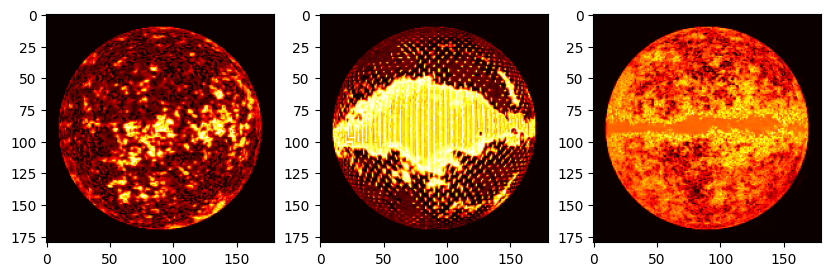

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))

Picking_Image_One = Microwave_IMG_List[22][:,:,0]
Picking_Image_Two = Microwave_IMG_List[2000][:,:,0]
Picking_Image_Three = Microwave_IMG_List[1000][:,:,0]

axis[0].imshow(Picking_Image_One,cmap="hot")
axis[1].imshow(Picking_Image_Two,cmap="hot")
axis[2].imshow(Picking_Image_Three,cmap="hot")

Visualizamos nuevamente el **canal rojo ([: ,: ,0])** de tres imágenes del fondo cósmico de microondas, pero aplicando una colormap diferente: **nipy_spectral**, lo que da un efecto más "arcoíris" con transiciones espectrales de colores. A diferencia de hot, que usa tonos térmicos clásicos, este mapa permite una mayor diferenciación entre niveles intermedios. Esto es particularmente útil para destacar patrones de ruido, identificar zonas saturadas o interferencias como el plano galáctico.

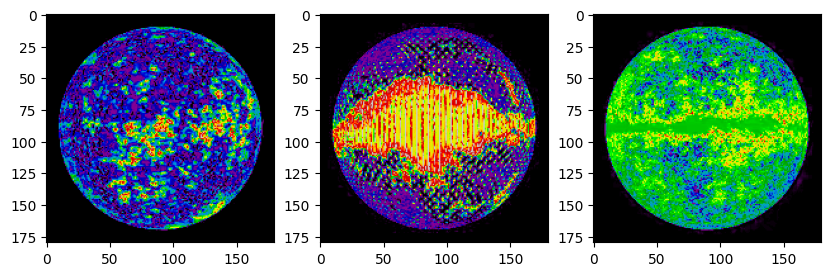

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))

Picking_Image_One = Microwave_IMG_List[22][:,:,0]
Picking_Image_Two = Microwave_IMG_List[2000][:,:,0]
Picking_Image_Three = Microwave_IMG_List[1000][:,:,0]

axis[0].imshow(Picking_Image_One).set_cmap('nipy_spectral')
axis[1].imshow(Picking_Image_Two).set_cmap('nipy_spectral')
axis[2].imshow(Picking_Image_Three).set_cmap('nipy_spectral')

Aquí mostramos una imagen representativa del fondo cósmico, específicamente su canal rojo, visualizada con la colormap nipy_spectral. La barra lateral de color cuantifica cada tono, permitiéndonos ver que las intensidades térmicas oscilan entre 0 y 255. Esta escala es crucial para interpretar científicamente las anisotropías del CMB, ya que pequeñas diferencias de intensidad están relacionadas con las condiciones del universo primitivo.

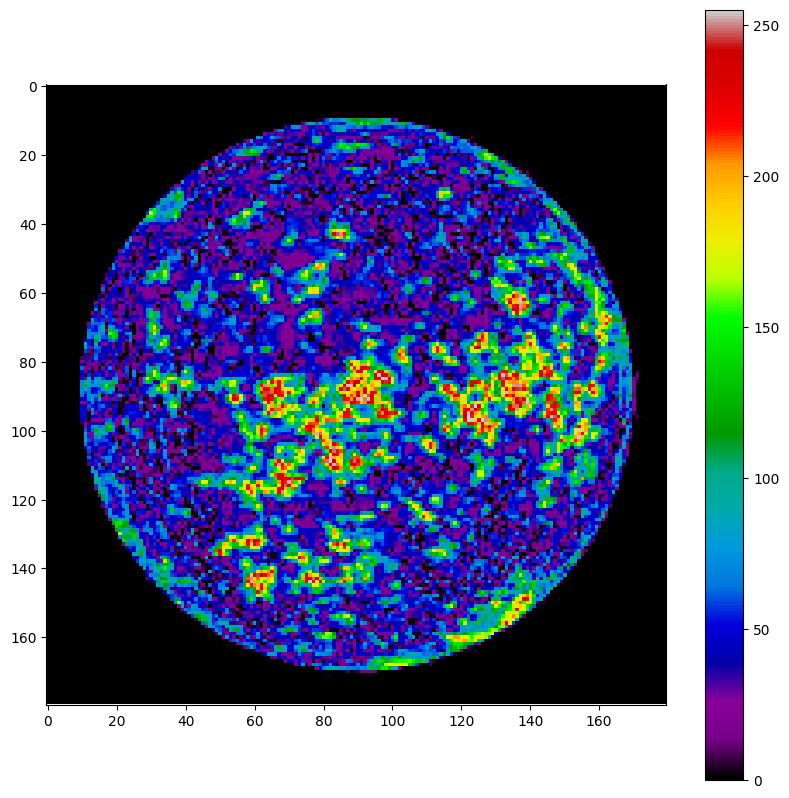

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

Plot_1 = plt.imshow(Picking_Image[:,:,0]).set_cmap('nipy_spectral')
plt.colorbar()

#añadir una barra de color (colorbar) a tu mapa espectral.
# Esta barra te permite cuantificar visualmente la escala de intensidades térmicas representadas en la imagen.

A continuación creamos un histograma de los valores de la imagen.

**Picking_Image.ravel()** Convierte la matriz 2D en un vector 1D para crear el histograma

**bins=180:** divide el rango de valores en 180 intervalos ya que tenemos 180 pixels

**range=(0.0, 10):** solo se consideran valores dentro de este rango

Este histograma muestra la distribución de intensidades del canal rojo en una imagen del fondo cósmico. Inicialmente limitamos el rango a 0–10, lo cual resultó en una concentración artificial de los datos en el primer bin. Al expandir el rango a 0–255, podremos observar una distribución real que nos permita entender si la imagen está saturada, sesgada hacia valores bajos, o bien distribuida. Este análisis es fundamental si queremos aplicar técnicas de normalización o filtrado basado en intensidad.

Notamos que hay una barra altísima en el primer bin que está cerca del 0, mientras que las demás barras son muy pequeñas y el que la mayoría de los píxeles tengan un valor cercano a 0 nos dice que la imagen está muy "oscura", con solo unas pocas regiones más brillantes o activas esto se debe a que el CMB es extremadamente uniforme, con fluctuaciones de temperatura del orden de microkelvins y como estas fluctuaciones son pequeñas comparadas con el fondo plano por eso hay tantos valores cercanos a 0.

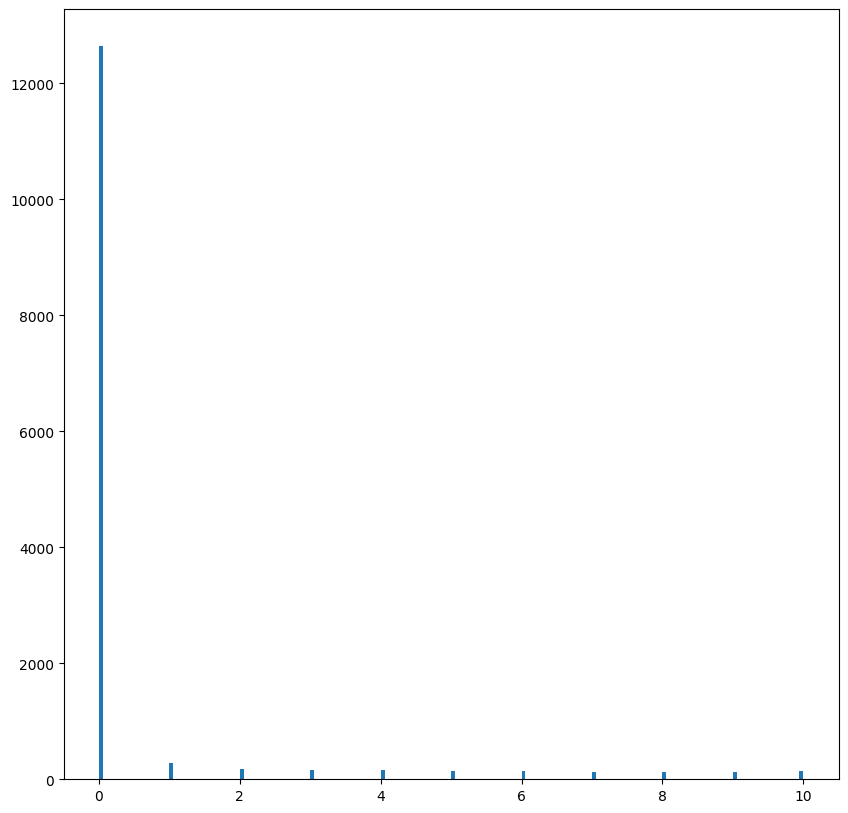

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22][:,:,0]

plt.hist(Picking_Image.ravel(), bins=180, range=(0.0, 10), fc='k', ec='k')
plt.show()

Filtro de visualización por rango de intensidades usando el parámetro clim=(1, 20) sobre el canal rojo de la imagen Microwave_IMG_List[22], con el colormap nipy_spectral. Para destacar solo los píxeles con intensidades muy bajas en el canal rojo. Esto permite observar zonas de baja energía, pero en este caso la mayoría de los datos útiles están fuera de ese rango. Esto demuestra que es importante ajustar adecuadamente la escala para no perder información relevante en la visualización.

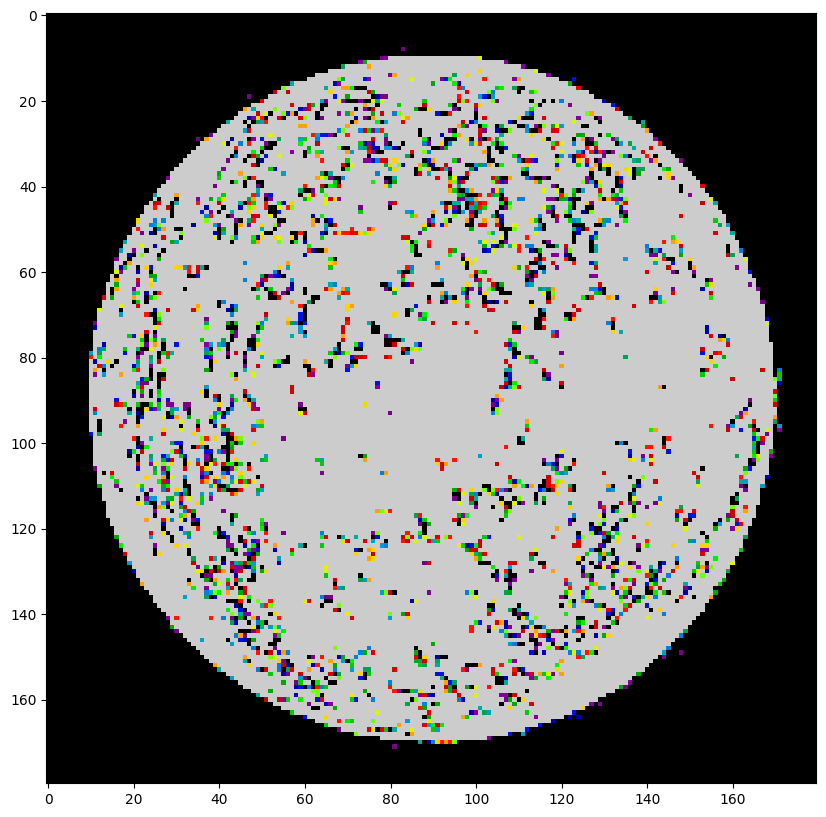

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

plt.imshow(Picking_Image[:,:,0],clim=(1,20)).set_cmap('nipy_spectral')

 Utilizando la opción interpolation="bicubic" al visualizar el canal rojo de la imagen del fondo cósmico de microondas (frame 22), lo cual suaviza la visualización y permite detectar patrones más continuos. Esto no altera los datos, pero sí la forma en que los percibimos visualmente, permitiendo identificar mejor los patrones grandes, como agrupamientos térmicos o anisotropías globales. Es especialmente útil cuando queremos interpretar la estructura general del CMB sin distracciones por píxeles individuales.

**ACLARACIÓN:**

Esto es una mejora visual. Para análisis cuantitativos o algoritmos de machine learning, se deben usar los datos originales sin interpolación, ya que esta técnica inventa valores intermedios.

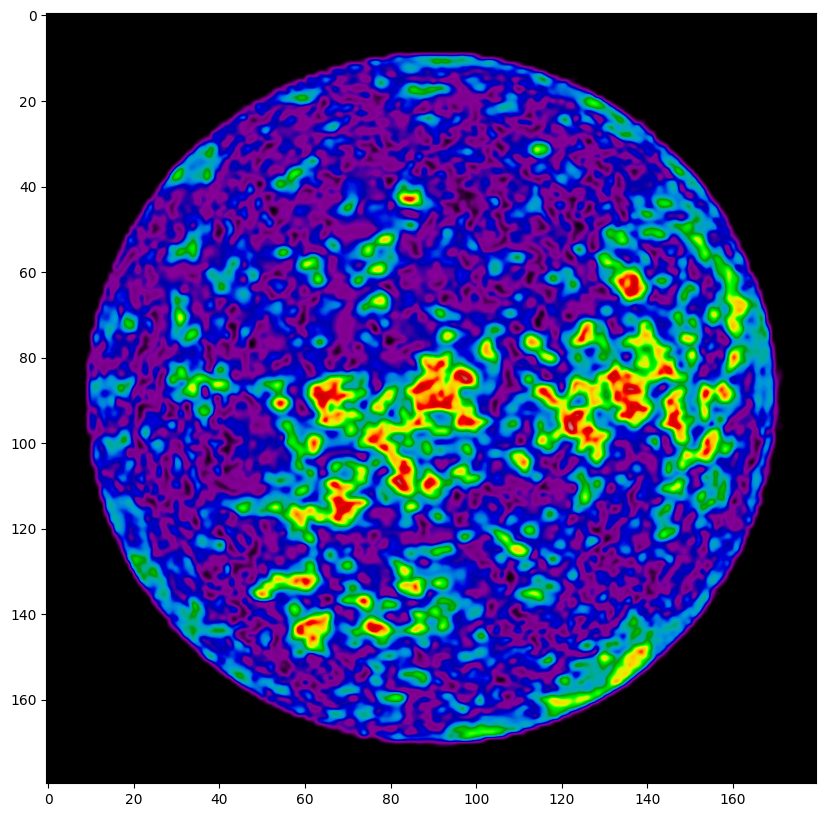

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

plt.imshow(Picking_Image[:,:,0],interpolation="bicubic").set_cmap('nipy_spectral')

Generar un mapa de contornos (plt.contour) a partir del canal rojo de la imagen Microwave_IMG_List[22], lo cual te permite resaltar niveles específicos de intensidad como si fueran curvas de nivel topográficas. Esta técnica es muy útil para representar visualmente variaciones espaciales y zonas de igual intensidad térmica.

Aquí utilizamos plt.contour para resaltar regiones donde la intensidad térmica coincide con valores específicos: 50 y 200. Esto nos permite identificar estructuras internas del fondo cósmico, como agrupamientos o anomalías de energía. Estas curvas son equivalentes a líneas de nivel en un mapa de elevación, y nos ayudan a entender cómo se distribuyen espacialmente las anisotropías térmicas.

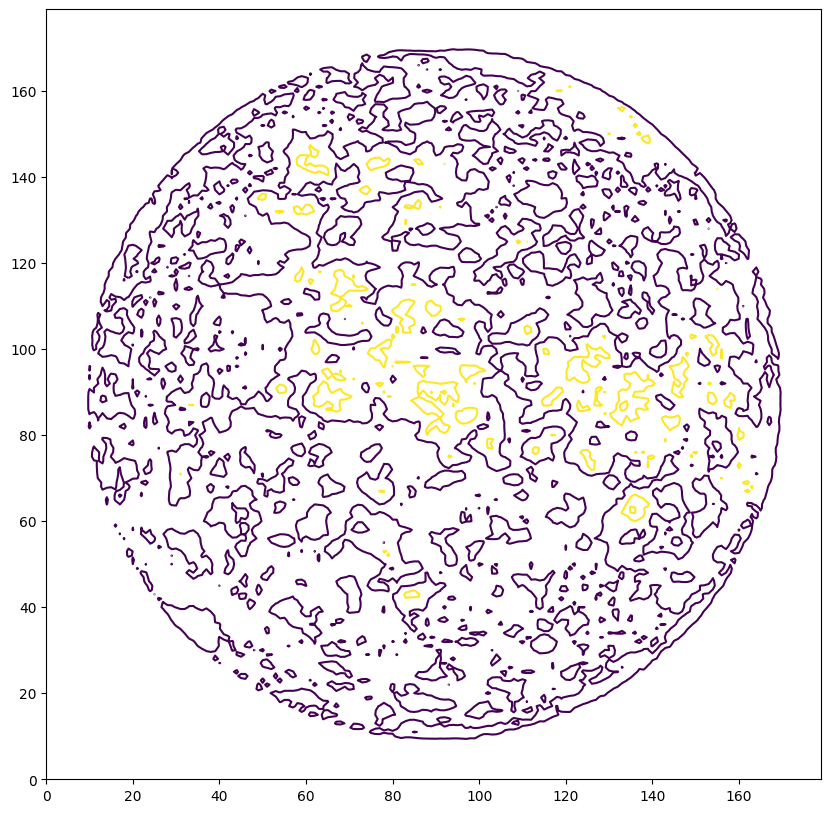

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22][:,:,0]

plt.contour(Picking_Image, [50, 200])

Realizar una transformación de brillo sobre la imagen del fondo cósmico de microondas (Microwave_IMG_List[22]). Estás aplicando una operación matemática para aumentar la luminosidad relativa de los píxeles. Sin embargo, el resultado no se visualiza correctamente debido a un problema de rango y formato.

Intentamos realzar el brillo de la imagen mediante una transformación que amplifica las diferencias entre intensidades bajas y altas. Sin embargo, al no controlar el rango de salida, matplotlib recortó los valores extremos, provocando una visualización distorsionada. Este ejercicio resalta la importancia de normalizar adecuadamente los datos antes de graficarlos.

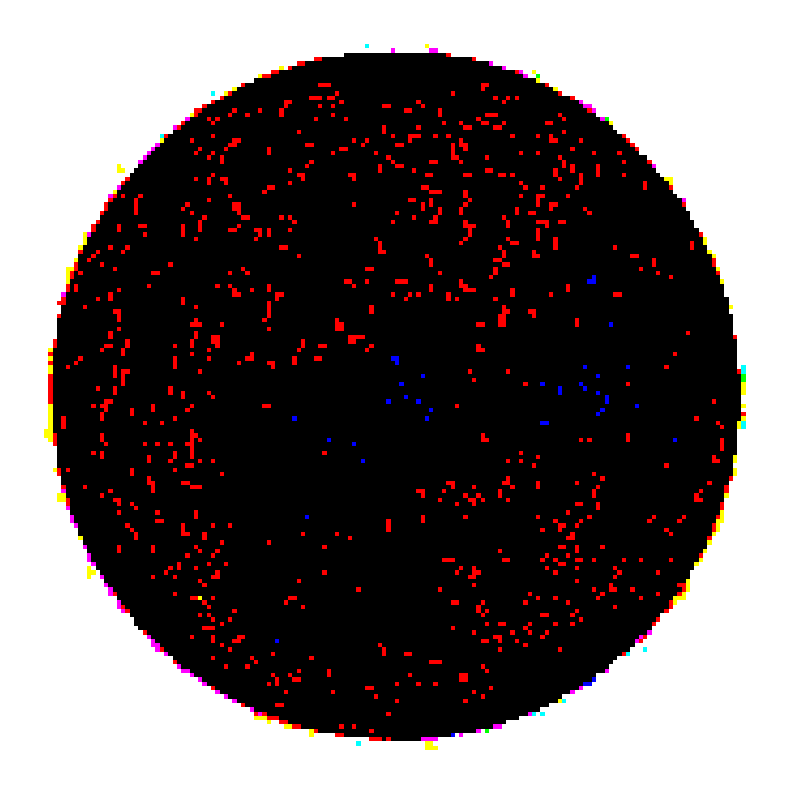

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

Bright_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 10

plt.axis("off")
plt.imshow(Bright_IMG)

Se disminuyó la ganancia multiplicadora a 0.10, pero todavía se está produciendo saturación, lo cual indica que los datos siguen fuera del rango que espera `imshow()`.

Aplicamos una técnica de ajuste de brillo con una fórmula que amplifica zonas oscuras. Sin embargo, matplotlib espera un rango específico para mostrar imágenes. Por eso, al no controlar ese rango, los valores saturados distorsionan la visualización. La solución es normalizar los datos antes de graficar, para asegurar una representación correcta sin pérdida de información.

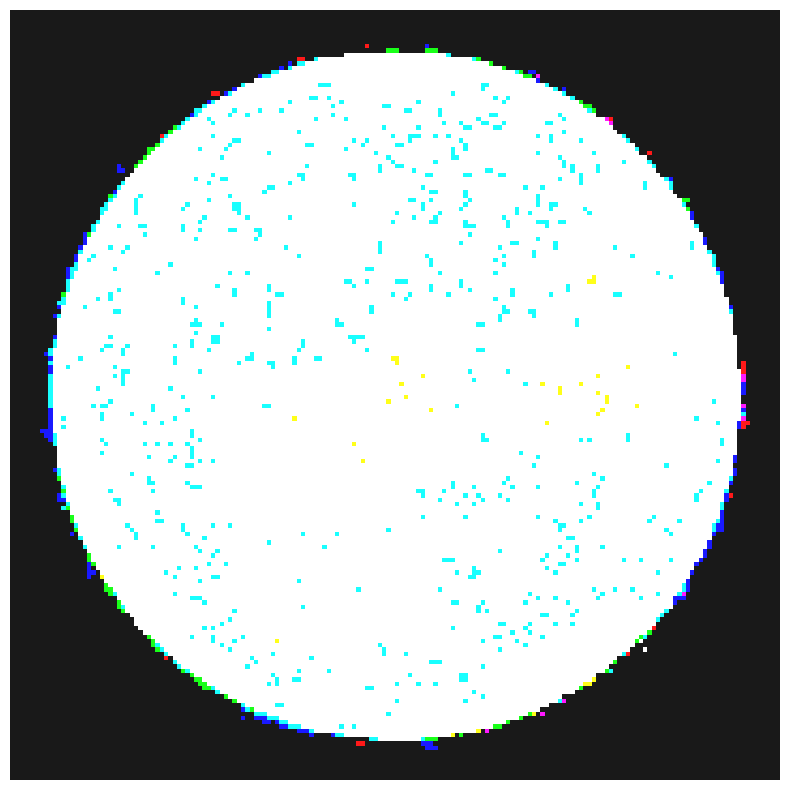

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

Bright_IMG = Picking_Image + (np.ones(Picking_Image.shape) - Picking_Image) * 0.10

plt.axis("off")
plt.imshow(Bright_IMG)

 Se prueba una operación para oscurecer la imagen del fondo cósmico de microondas `(Microwave_IMG_List[22])`, pero el resultado actual muestra un patrón aleatorio multicolor que no corresponde a un oscurecimiento válido, lo cual indica un error de tipo o canal de color, una visualización corrupta. Para modificar el brillo correctamente, debemos convertir la imagen a tipo float, aplicar la transformación, recortar a 255, y convertir de nuevo a uint8 para garantizar una visualización válida.

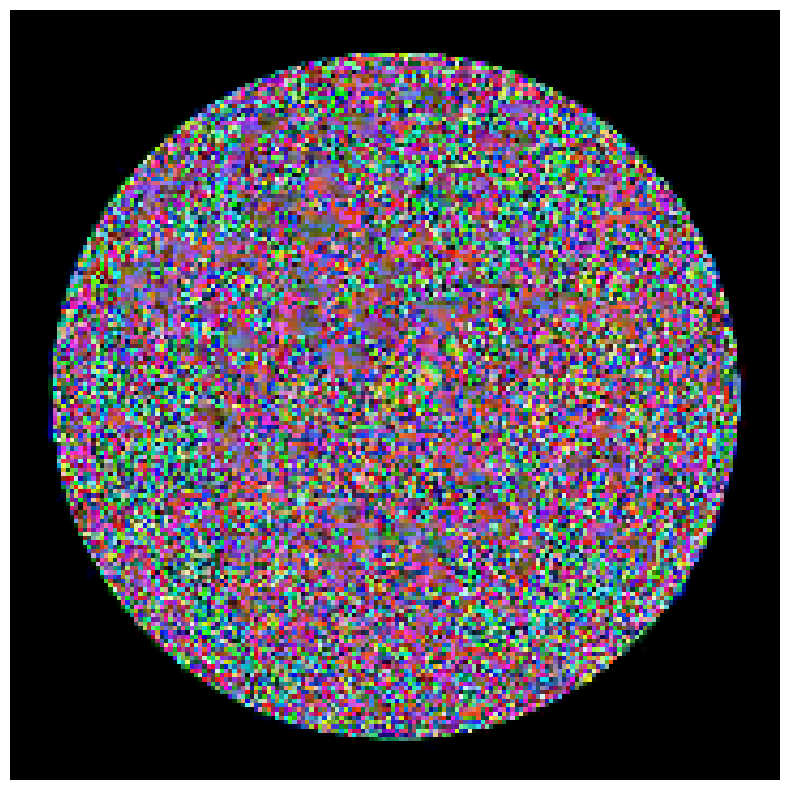

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

Dark_IMG = Picking_Image * (9 - 5)

plt.axis("off")
plt.imshow(Dark_IMG)

 En esta celda se está intentando generar una imagen RGB artificialmente coloreada, construyendo canales R, G y B a partir del canal rojo ([ : , : , 0 ]) de la imagen original. Esto es útil para experimentar con combinaciones de color que resalten distintas características térmicas. Sin embargo, la advertencia indica que los valores de color están fuera del rango válido. Es importante asegurarse de que los datos estén normalizados al rango correcto, de lo contrario matplotlib los recortará y se perderán detalles visuales.

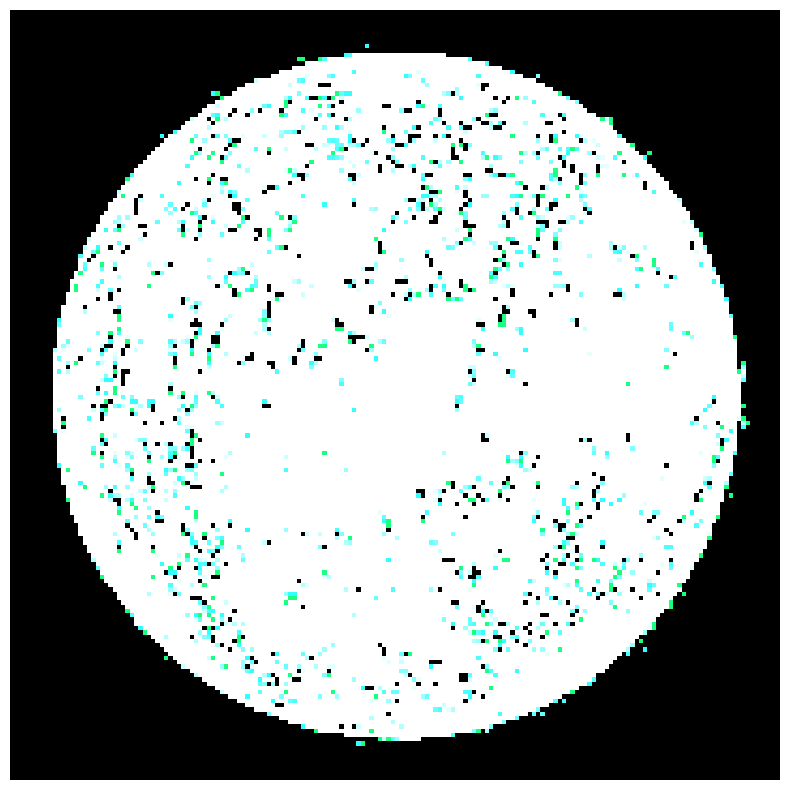

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22][:,:,0]

Spes_Color_IMG = np.dstack((Picking_Image*0.1, Picking_Image*1, Picking_Image*0.5))

plt.axis("off")
plt.imshow(Spes_Color_IMG)

# Histogramas reales

 Estás mostrando aquí es el histograma de color por canal RGB de la imagen Microwave_IMG_List[22]. Esta visualización es fundamental para entender la distribución de intensidades de cada componente de color y cómo contribuyen al aspecto final de la imagen.

 Este histograma muestra cómo se distribuyen los niveles de color en nuestra imagen original del fondo cósmico. Cada canal RGB tiene su propia firma: el verde domina en intensidad intermedia, el azul se dispersa ampliamente y el rojo está más contenido en valores bajos. Esta información es clave para ajustar brillo, contraste y color artificialmente, así como para analizar componentes específicos.

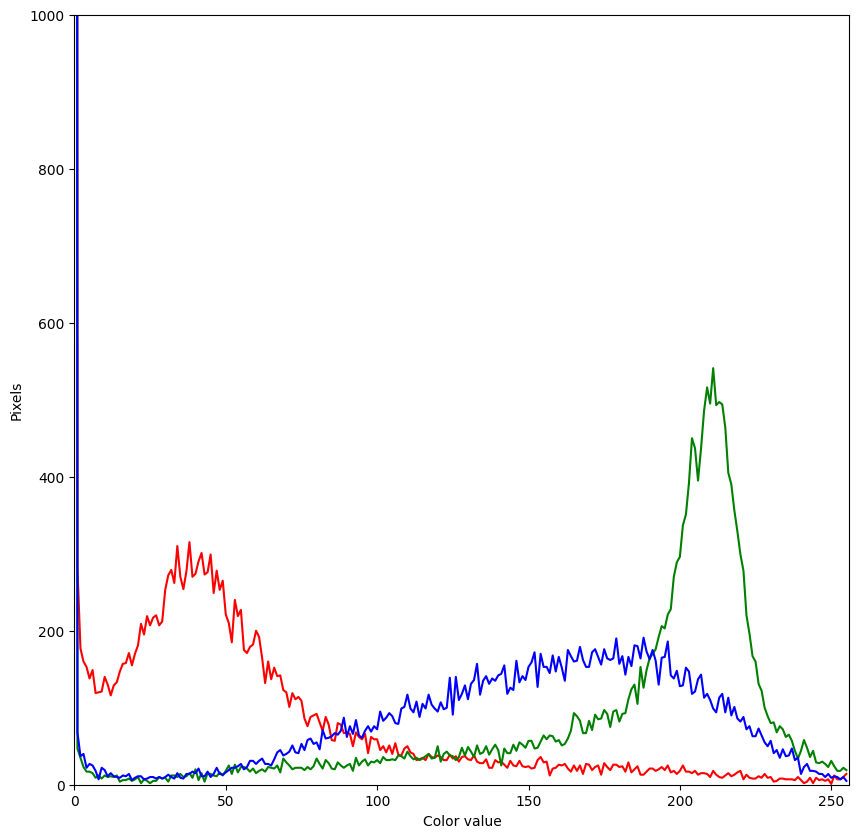

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[22]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

Grafica de los histogramas de los valores de color (RGB) para la imagen Microwave_IMG_List[202], que representa un frame específico del fondo cósmico de microondas (CMB).

Un histograma de color muestra cuántos píxeles tienen una cierta intensidad en cada canal (Rojo, Verde, Azul), lo que permite analizar:

* Brillo
* Contraste
* Saturación
* Equilibrio de color

Aquí estamos analizando el histograma RGB del frame 202 del video de la radiación de fondo cósmico. Este gráfico muestra cuántos píxeles hay para cada nivel de color. Por ejemplo, observamos que el canal verde tiene una fuerte presencia alrededor de 200, lo cual sugiere que en este frame predominan los tonos verdes. Esto es útil para entender cómo se distribuyen las intensidades térmicas en la imagen, ya que el color está directamente ligado a la temperatura en mapas como este.

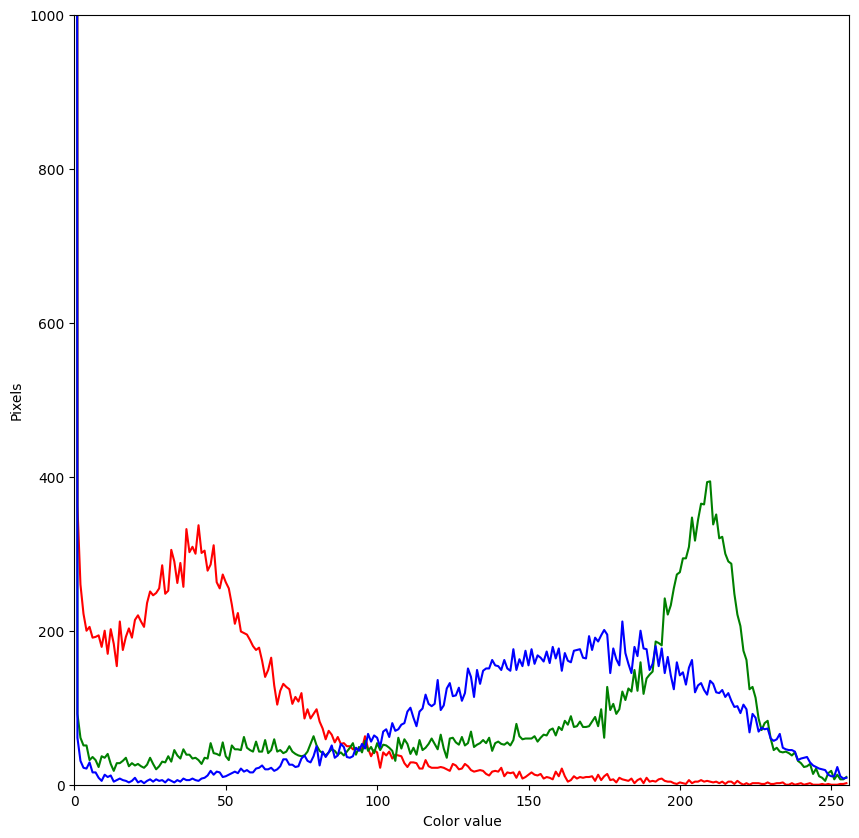

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[202]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

Ahora lo que se hizo fue analizar los niveles de color en una imagen específica del fondo cósmico de microondas, en este caso la número 202 del conjunto de datos.

Para esto, separé la imagen en sus tres canales de color: rojo, verde y azul. Luego, para cada canal, conté cuántos píxeles tienen cada valor de intensidad, desde 0 hasta 255.

Eso se conoce como un histograma de color, y básicamente nos dice qué tan presentes están los diferentes tonos de cada color en la imagen.
En la gráfica pueden ver tres curvas:
* La curva roja representa el canal rojo,
* la verde representa el canal verde,
* y la azul representa el canal azul.

En el eje horizontal están los valores de intensidad del color, desde 0 (muy oscuro) hasta 255 (muy brillante).

En el eje vertical está el número de píxeles que tienen esa intensidad.
Por ejemplo, si una curva tiene un pico en valores bajos, eso significa que hay muchas zonas oscuras de ese color en la imagen.

Este tipo de análisis es útil porque nos da una idea cuantitativa de cómo está compuesta la imagen, y si lo comparamos con otras imágenes, podríamos incluso detectar diferencias térmicas o estructurales en distintas etapas del universo.

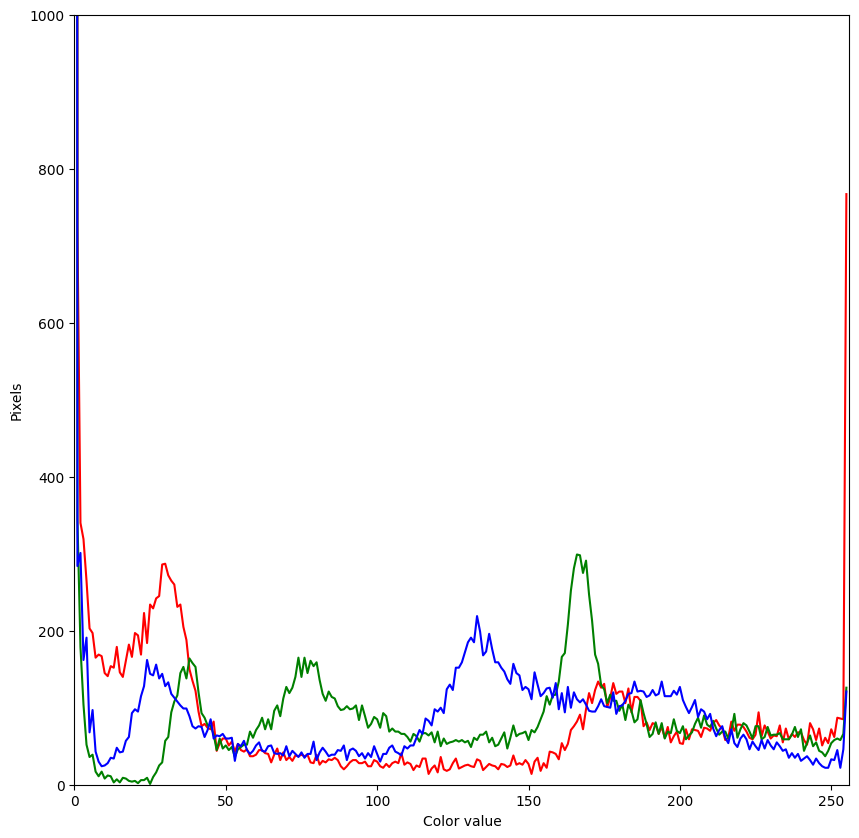

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[2000]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

En esta celda, lo que hicimos fue generar un histograma por canal de color —rojo, verde y azul— de una de las imágenes del fondo cósmico de microondas, en específico la número 1300.

Primero, extraemos la imagen con Microwave_IMG_List[1300], y después tomamos sus tres canales de color. Creamos un histograma para cada canal con 256 bins, que corresponden a los niveles posibles de intensidad de color, que van del 0 al 255.

Este histograma nos permite visualizar cuántos píxeles tienen cierta intensidad para cada color. Por ejemplo, si una imagen tiene muchos valores bajos en azul, eso indica que el canal azul tiene predominancia de zonas oscuras.

En el gráfico de abajo, en el eje X tenemos los valores de color, y en el eje Y el número de píxeles que presentan ese valor. La línea roja representa el canal rojo, la verde al canal verde, y la azul al azul.

Esto es útil para analizar la distribución cromática de las imágenes, por ejemplo, para saber si una imagen está sobreexpuesta, subexpuesta o si hay predominancia de ciertos colores que podrían corresponder a ciertas zonas del universo en el fondo cósmico.

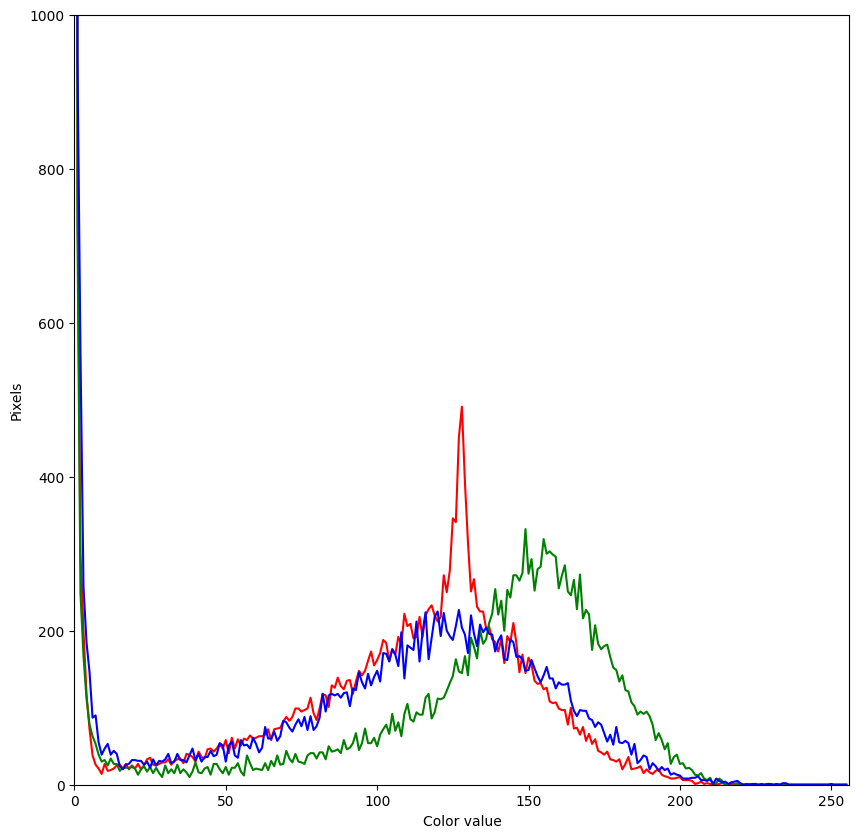

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Microwave_IMG_List[1300]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

# DATA PROCESS

#### PARAMETERS

En esta celda se definen los **parámetros iniciales** para el modelo, como cuántas iteraciones va a correr, cuántos ejemplos vamos a generar, y de qué tamaño será cada vector de ruido. Luego, con tf.random.normal, genero una matriz de vectores aleatorios de forma [20, 180], donde cada vector servirá como entrada aleatoria para el modelo. Esta entrada aleatoria es importante porque nos permite generar ejemplos distintos cada vez, simulando variabilidad natural. En redes generativas, estos vectores**son la base sobre la que se construyen las imágenes o patrones.**

In [ ]:
iterations = 60
vector_noise_shape = 180
count_example = 20
batch_size = 6
count_buffer = 60000

In [ ]:
seed = tf.random.normal([count_example, vector_noise_shape])

#### TRANSFORMATION

1.-Estamos **extrayendo todos los frames** del video Third_Year_Microwave. A cada uno se aplica **una conversión a formato RGB y lo redimensionamos a 180x180 píxeles.** Esto lo hacemos para **estandarizar los datos** que van a entrar al modelo. Una vez que tenemos todas las imágenes, las convertimos en un array de NumPy, las normalizamos dividiéndolas entre 255, y luego las convertimos en un dataset de TensorFlow que ya está barajado y dividido por lotes. Este dataset es lo que usaremos para entrenar el modelo.

In [ ]:
Video_IMG_List = []

Video_Cap = cv2.VideoCapture(Third_Year_Microwave)


while Video_Cap.isOpened():


    ret,frame = Video_Cap.read()

    if ret != True:
        break

    if Video_Cap.isOpened():
        Transformation_IMG = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
        Resize_IMG = cv2.resize(Transformation_IMG,(180,180))
        Video_IMG_List.append(Resize_IMG)


Video_Cap.release()

2.-Convierte la lista **Video_IMG_Listen un array de NumPy.**
*Los arrays de NumPy son más eficientes para operaciones numéricas y son el formato estándar para alimentar datos a TensorFlow.

In [ ]:
X_Train = np.array(Video_IMG_List)

3.-Normaliza los valores

4.-
- 864: Número total de frames extraídos del video.
- 180, 180: Dimensiones de cada frame (alto y ancho).
- 3: Número de canales (RGB).

In [ ]:
X_Train = X_Train / 255.0
print(X_Train.shape)

(864, 180, 180, 3)


Convierte X_Train en un objeto tf.data.Dataset, mezcla los datos aleatoriamente usando un búfer de tamaño count_buffer y los agrupa en lotes de tamaño batch_size.

In [ ]:
Train_Data = tf.data.Dataset.from_tensor_slices(X_Train).shuffle(count_buffer).batch(batch_size)

NameError: name 'tf' is not defined

In [ ]:
print(Train_Data.element_spec)

TensorSpec(shape=(None, 180, 180, 3), dtype=tf.float64, name=None)


#### GENERATOR MODEL

**¿Por qué es secuencial?**

El modelo secuencial en Keras se usa para construir la DCGAN porque permite apilar capas linealmente (como `Conv2D`, `Conv2DTranspose`, `LeakyReLU`, `BatchNormalization`) de forma simple y eficiente, ideal para las arquitecturas del **generador** (que crea imágenes sintéticas de 180x180 píxeles a partir de ruido aleatorio) y el **discriminador** (que evalúa si las imágenes son reales o falsas). Es adecuado para esta DCGAN, ya que no requiere conexiones complejas como múltiples entradas o conexiones residuales, donde sería necesario usar la API funcional o un modelo personalizado.

**EXPLICACIÓN:**

Este bloque define el modelo generador del GAN. Lo que hace es tomar un vector de ruido de dimensión 180 y transformarlo, paso a paso, en una imagen RGB de 180×180 píxeles.
Primero, el vector se convierte en una estructura 90×90×128, que luego es reescalada y refinada con capas de deconvolución.
Las capas BatchNormalization ayudan a que el modelo sea más estable y las LeakyReLU evitan que se apaguen neuronas. Al final, la última capa nos da la imagen RGB usando activación tanh, que es ideal para normalización de imágenes.
Este generador intentará engañar al discriminador produciendo imágenes sintéticas lo más parecidas posible a las reales del fondo cósmico de microondas.

La función `Generator_Model` toma como entrada un vector aleatorio que esencialmente es ruido y produce una imagen sintética que simula las características estadísticas del CMB.
- Primero se inicia un modelo secuencial.
- En la línea
```python
Model.add(Dense(90*90*128,use_bias=False,input_shape=(180,)))
```
Se toma nuestro vector de ruído y lo vuelve un tensor plano de tamaño 90 * 90 * 128 = 1,036,800, cabe destacar que no se le aplica un bias o sesgo ya que se ocupa la línea `use_bias=False`. Se aplica Batch Normalization. Y por último se elije como función de activación `LeakyReLU`
-- ¿Por qué `LeakyReLU`? Es como `ReLU` normal pero aquí acepta valores negativos metiendo un pequeño gradiente a esos valores haciendo que las neuronas no "mueran".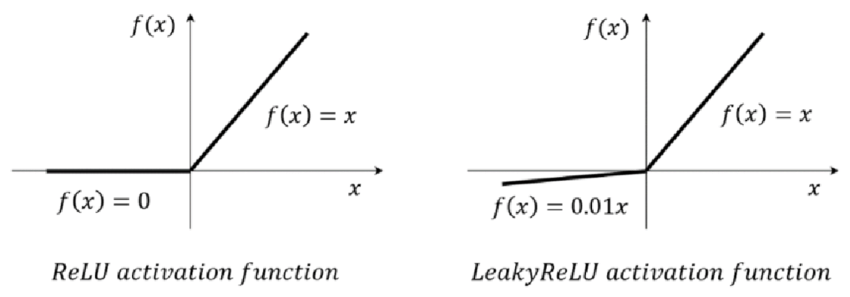


- Con la línea
```python
Model.add(Reshape((90,90,128)))
```
Convierte el tensor plano en un mapa de características 2D, que ahora puede ser "escalado" a una imagen a través de convoluciones transpuestas (upsampling).
- Con
```python
Model.add(Conv2DTranspose(128,(3,3),padding="same",use_bias=False))
Model.add(BatchNormalization())
Model.add(LeakyReLU())
```
Aplica una convolución transpuesta que mantiene el tamaño (90x90) pero va refinando los patrones con 128 filtros.
- En el cuarto bloque de código
```python
Model.add(Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', use_bias=False))
Model.add(BatchNormalization())
Model.add(LeakyReLU())
```
Se hace una convolución transpuesta similar a la anterior, aquí se hace el upsampling real: strides=(2,2) y duplica el tamaño espacial pasando de 90x90 a 180x180 y también reduce el número de filtros a 64, acercándose a una imagen RGB.
- Por último con
```python
Model.add(Conv2DTranspose(3,(3,3),padding="same",use_bias=False,activation="tanh"))
```
Es lo que produce la imagen RGB final de tamaño (180, 180, 3) donde usamos `tanh` como activación para que los valores estén entre [-1, 1] ya que los datos reales también estén normalizados a este rango.

In [ ]:
def Generator_Model():


    Model = Sequential()
    #Un capa se pasa como entrada de otra
    Model.add(Dense(90*90*128,use_bias=False,input_shape=(180,)))
    #Crea capa densa/ Proyecta vector de ruido a * * * / Términos de sesgo
    Model.add(BatchNormalization())
    #Aplica Normalización por lotes 1 (Estabiliza, converger rápido, sea robusto)
    Model.add(LeakyReLU())
    #Función de activación 1 (no linealidad en el modelo)
    Model.add(Reshape((90,90,128)))
    #Restructura el vector de 1,036,800 ele. a un tensor 4D/ imag. intermedia


    Model.add(Conv2DTranspose(128,(3,3),padding="same",use_bias=False))
    #Convolución transpuesta. Filtro/Kernel/Manteniendo el tam.espa.
    Model.add(BatchNormalization())
    #Normaliza por lotes 2
    Model.add(LeakyReLU())
    #Función de activación 1

    Model.add(Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', use_bias=False))
    #Convolución transpuesta. filtros, kernel, duplicamos tam,
    Model.add(BatchNormalization())
    #Normaliza por lotes 3
    Model.add(LeakyReLU())
    #Función de activación 3
    Model.add(Conv2DTranspose(3,(3,3),padding="same",use_bias=False,activation="tanh"))
    #Convolución transpuesta.Filtros, Canales, Tam. espacial, ,Función activación [-1,1]


    return Model

In [ ]:
Generator = Generator_Model()

Arquitectura detallada del generador. Empieza con una capa densa que expande el vector de entrada a un espacio latente muy grande. Luego normalizamos y aplicamos funciones de activación.
Posteriormente, el modelo reestructura los datos en forma de imagen y aplica varias capas de deconvolución (Conv2DTranspose) para generar una imagen RGB de 180x180 píxeles.
La mayoría de los parámetros entrenables están en la primera capa densa, lo cual es típico en este tipo de redes generativas. Al final, usamos tanh para normalizar la salida entre -1 y 1, como se espera en GANs.
En total, este modelo tiene aproximadamente 190 mil de parámetros, lo cual lo hace potente pero también costoso computacionalmente.

In [ ]:
print(Generator.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 1036800)        │   186,624,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1036800)        │     4,147,200 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 1036800)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 90, 90, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 90, 90, 128)    │       147,456 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 90, 90, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 90, 90, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 180, 180, 64)   │        73,728 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 180, 180, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 180, 180, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 180, 180, 3)    │         1,728 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 190,994,880 (728.59 MB)

 Trainable params: 188,920,896 (720.68 MB)

 Non-trainable params: 2,073,984 (7.91 MB)

None


#### DISCRIMINATOR MODEL

El modelo discriminador actúa como un clasificador binario que toma una imagen de entrada y predice si es real (se denota con 1) o falsa (se denota con 0) y así aprende a reconocer las características de las imágenes de los mapas del CMB.

Como se explica arriba se aplica un modelo secuencial, ya que la arquitectura del discriminador es lineal, con capas apiladas una tras otra.

El primer bloque del codigo es:

```python
Model.add(Conv2D(64,(3,3),padding="same",input_shape=[180,180,3]))
Model.add(Dropout(0.2))
Model.add(LeakyReLU())
```
- Lo que hacemos es que con `Conv2D(64, (3,3), padding="same") ` aplicamos 64 filtros de tamaño 3x3 ocupando padding conservamos el tamaño original de 180x180
- Con ` Dropout(0.2) ` simplemente se hace el dropout del 20% de las neuronas
- Por último con `LeakyReLU()` se le aplica la no linealidad al modelo ya que a diferencia de ReLU, permite un pequeño gradiente para entradas negativas, lo que ayuda a evitar que las neuronas "mueran"

El segundo bloque está dado por:

```python
Model.add(Conv2D(128,(3,3),padding="same"))
Model.add(Dropout(0.2))
Model.add(LeakyReLU())
```
- Para este bloque se hace exactamente lo mismo que en el anterior, el único cambio es que se usan 128 filtros en vez de 64

Por último tenemos el siguiente bloque:
```python
Model.add(layers.Flatten())
Model.add(layers.Dense(1))
```
- Aquí con `Flatten():` convertimos el tensor con dimensiones (180x180x128) en un vector 1D.
- Con `Dense(1):` produce una sola salida (logit), es decir, un número real que luego se usará en la función de pérdida la cual se definirá a continuación.

In [ ]:
#Genaro

def Discriminator_Model():

    Model = Sequential()

    Model.add(Conv2D(64,(3,3),padding="same",input_shape=[180,180,3]))
    Model.add(Dropout(0.2))
    Model.add(LeakyReLU())


    Model.add(Conv2D(128,(3,3),padding="same"))
    Model.add(Dropout(0.2))
    Model.add(LeakyReLU())

    Model.add(layers.Flatten())
    Model.add(layers.Dense(1))

    return Model

In [ ]:
Discriminator = Discriminator_Model()

In [ ]:
print(Discriminator.summary())

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 180, 180, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 180, 180, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 180, 180, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 180, 180, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 180, 180, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 180, 180, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 4147200)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │     4,147,201 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,222,849 (16.11 MB)

 Trainable params: 4,222,849 (16.11 MB)

 Non-trainable params: 0 (0.00 B)

None


Con este modelo discriminador hacemos que la red aprenda a identificar patrones realistas de las imágenes del CMB ya que tienen patrones específicos de textura y color y con este modelo el discriminador trata de capturar estas señales para diferenciar entre las imágenes reales reales y las generadas.

#### LOSS FUNCTIONS

A continuación se define la función `BinaryCrossentropy` que es una función de pérdida binaria que mide la diferencia entre etiquetas verdaderas (dadas por 0 o 1) y las predicciones del modelo (que se da con logits).

- Con "logits" nos referimos a los valores crudos de salida del modelo antes de aplicar una función sigmoide.

In [ ]:
Loss_Function = tf.keras.losses.BinaryCrossentropy(from_logits=True)

Ahora se **define la pérdida de nuestro modelo discriminador**
- Primero se toma como `real_out` a las predicciones del discriminador para imágenes reales, mientras que `fake_out` a las predicciones del discriminador para imágenes falsas.
- Con
```python
real_loss_function = Loss_Function(tf.ones_like(real_out), real_out)
```
Se crea un tensor de etiquetas 1 del mismo tamaño que `real_out` ocupando `tf.ones_like(real_out)` para comparar contra las predicciones.
- Con
```python
fake_loss_function = Loss_Function(tf.zeros_like(fake_out),fake_out)
```
Se crea un tensor de etiquetas 0 del mismo tamaño que `fake_out` ocupando `tf.zeros_like(fake_out)` para comparar contra las predicciones.
- Por último con
```python
total_loss = real_loss_function + fake_loss_function
```
Definimos la pérdida total del discriminador es simplemente la suma de la pérdida al clasificar mal imágenes reales como falsas más la pérdida al clasificar mal imágenes falsas como reales.

In [ ]:
def Discriminator_Loss(real_out,fake_out):

    real_loss_function = Loss_Function(tf.ones_like(real_out),real_out)
    fake_loss_function = Loss_Function(tf.zeros_like(fake_out),fake_out)
    total_loss = real_loss_function + fake_loss_function

    return total_loss

Similarmente se define la pérdida del modelo generador

In [ ]:
def Generator_Loss(fake_output):

    return Loss_Function(tf.ones_like(fake_output),fake_output)

#### OPTIMIZERS

In [ ]:
Generator_Optimizer = RMSprop(learning_rate=0.0003,clipvalue=1.0,decay=1e-8)
Discriminator_Optimizer = RMSprop(learning_rate=0.0003,clipvalue=1.0,decay=1e-8)

#### GENERATING AND SAVING IMAGE

In [ ]:
def generate_and_save_images(model, epoch, test_input):

    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(11, 11))

    for i in range(predictions.shape[0]):
        plt.subplot(6, 6, i+1)
        plt.imshow(predictions[i, :, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### TRAINING STEP

Para la función `Train_Step` representamos una iteración de entrenamiento de la DCGAN, donde en cada llamada:

1. Se generan imágenes falsas con el generador.

2. Se evalúan imágenes reales y falsas con el discriminador.

3. Se calcula la pérdida del generador y del discriminador.

4. Se calculan los gradientes y se actualizan ambos modelos usando los optimizadores.

Viendo línea a línea tenemos que
- Primero toma imputs de imágenes
- Después con
```python
random_noise_vector = tf.random.normal([batch_size, vector_noise_shape])
```
Se crea un vector de ruido con las dimensiones que definimos (180) y con el tamaño de batch definido (6)

- Con
```python
with tf.GradientTape() as Generator_Tape, tf.GradientTape() as Discriminator_Tape:
```
Se abren dos tapes de TensorFlow para grabar las operaciones y calcular los gradientes

- Con
```python
Generator_Fake_Image = Generator(random_noise_vector, training=False)
```
Se generan imágenes falsas a partir del ruido y con `training=False` lo que hacemos es desactivar capas como Dropout o BatchNorm en modo entrenamiento

- Con
```python
real_output = Discriminator(images, training=True)
fake_output = Discriminator(Generator_Fake_Image, training=True)
```
Se toma como entradas `images` que son las imágenes reales del dataset y `Generator_Fake_Image` que son las imágenes falsas generadas por el generador y ambas se evalúan en `training=True` porque el discriminador está aprendiendo a distinguir.
- Con
```python
Generator_Loss_Output = Generator_Loss(fake_output)
```
Simplemente se calcula la pérdida del generador, aquí el objetivo del generador es "engañar" al discriminador, por lo que intenta que el discriminador crea que las imágenes falsas son reales (por eso se compara con `tf.ones_like(fake_output)` en la función `Generator_Loss`).

- Con
```python
Discriminator_Loss_Output = Discriminator_Loss(real_output, fake_output)
```
Se calcula la pérdida del discriminador, donde Se suman dos errores de qué tan bien identifica las imágenes reales como reales y qué tan bien identifica las imágenes falsas como falsas.

- Con
```python
Generator_Gradients = Generator_Tape.gradient(Generator_Loss_Output, Generator.trainable_variables)
Discriminator_Gradients = Discriminator_Tape.gradient(Discriminator_Loss_Output, Discriminator.trainable_variables)
```
Calculamos los gradientes de las pérdidas respecto a los pesos de cada red, con `Generator.trainable_variables` tomamos los pesos ajustables del generador y con `Discriminator.trainable_variables` los pesos ajustables del discriminador.

- Y por último con
```python
Generator_Optimizer.apply_gradients(zip(Generator_Gradients, Generator.trainable_variables))
Discriminator_Optimizer.apply_gradients(zip(Discriminator_Gradients, Discriminator.trainable_variables))
```
Solo aplicamos los gradientes para actualizar los pesos.

In [ ]:
def Train_Step(images):

    random_noise_vector = tf.random.normal([batch_size,vector_noise_shape])

    with tf.GradientTape() as Generator_Tape, tf.GradientTape() as Discriminator_Tape:

        Generator_Fake_Image = Generator(random_noise_vector,training=False)

        real_output = Discriminator(images,training=True)
        fake_output = Discriminator(Generator_Fake_Image,training=True)

        Generator_Loss_Output = Generator_Loss(fake_output)
        Discriminator_Loss_Output = Discriminator_Loss(real_output,fake_output)

    Generator_Gradients = Generator_Tape.gradient(Generator_Loss_Output,Generator.trainable_variables)
    Discriminator_Gradients = Discriminator_Tape.gradient(Discriminator_Loss_Output,Discriminator.trainable_variables)

    Generator_Optimizer.apply_gradients(zip(Generator_Gradients,Generator.trainable_variables))
    Discriminator_Optimizer.apply_gradients(zip(Discriminator_Gradients,Discriminator.trainable_variables))


Esta celda define una función `Training` que entrena la DCGAN durante un número especificado de iteraciones (`iterations`) usando un conjunto de datos (`dataset`, que aquí es `Train_Data`). Para cada época, itera sobre lotes de imágenes (`image_batch`) del conjunto de datos y aplica el paso de entrenamiento (`Train_Step`) al modelo. Luego, limpia la salida de la consola (`display.clear_output`) y genera imágenes sintéticas usando la función `generate_and_save_images` dos veces por época: una con `epoch+1` y otra con `epoch`, pasando el generador (`Generator`) y una semilla (`seed`). Finalmente, se llama a la función `Training` con los datos `Train_Data` y el número de iteraciones `iterations`, iniciando el proceso de entrenamiento de la DCGAN.


In [ ]:
def Training(dataset,iterations):

    for epoch in range(iterations):
        start = time.time()

        for image_batch in dataset:
            Train_Step(image_batch)

        display.clear_output(wait=True)
        generate_and_save_images(Generator,epoch+1,seed)

    display.clear_output(wait=True)
    generate_and_save_images(Generator,epoch,seed)

# TRAIN PROCESS

Esta celda muestra una cuadrícula de 16 imágenes generadas por el generador de la DCGAN durante el proceso de entrenamiento, como parte de la función Training(Train_Data, iterations). Las imágenes son mapas del fondo cósmico de microondas (CMB) en escala de grises, creadas a partir de ruido aleatorio pasado al generador (Generator). La visualización permite monitorear el progreso del entrenamiento, evaluando si las imágenes generadas se asemejan a los mapas reales de CMB en términos de patrones y fluctuaciones.



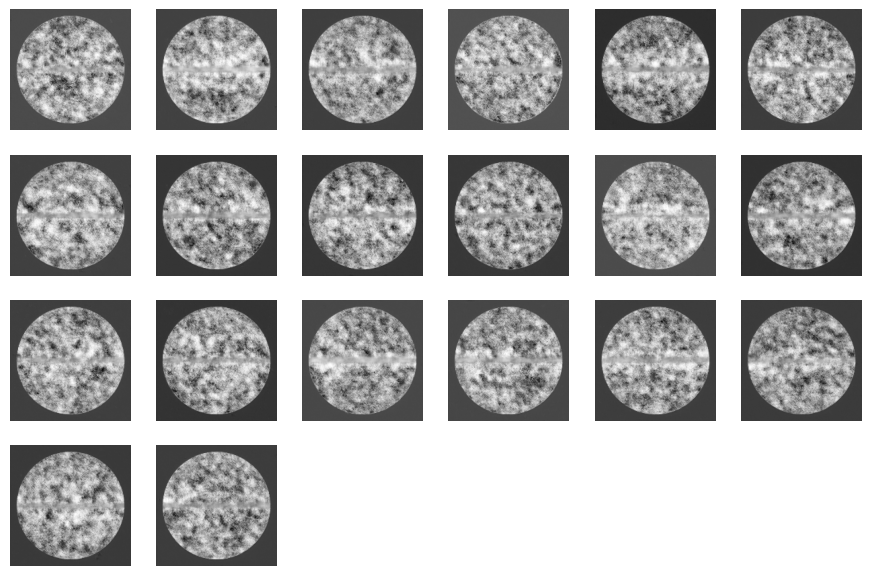

In [ ]:
Training(Train_Data,iterations)

# PREDICTION RESULT

#### WHAT IS DOPPLER?

* The Doppler effect for electromagnetic waves such as light is of great use in astronomy and results in either a so-called redshift or blueshift. It has been used to measure the speed at which stars and galaxies are approaching or receding from us; that is, their radial velocities. This may be used to detect if an apparently single star is, in reality, a close binary, to measure the rotational speed of stars and galaxies, or to detect exoplanets. This redshift and blueshift happens on a very small scale. If an object was moving toward earth, there would not be a noticeable difference in visible light, to the unaided eye.

* Note that redshift is also used to measure the expansion of space, but that this is not truly a Doppler effect. Rather, redshifting due to the expansion of space is known as cosmological redshift, which can be derived purely from the Robertson-Walker metric under the formalism of General Relativity. Having said this, it also happens that there are detectable Doppler effects on cosmological scales, which, if incorrectly interpreted as cosmological in origin, lead to the observation of redshift-space distortions.

* The use of the Doppler effect for light in astronomy depends on our knowledge that the spectra of stars are not homogeneous. They exhibit absorption lines at well defined frequencies that are correlated with the energies required to excite electrons in various elements from one level to another. The Doppler effect is recognizable in the fact that the absorption lines are not always at the frequencies that are obtained from the spectrum of a stationary light source. Since blue light has a higher frequency than red light, the spectral lines of an approaching astronomical light source exhibit a blueshift and those of a receding astronomical light source exhibit a redshift.

![](https://scx2.b-cdn.net/gfx/news/2016/rotationaldo.jpg)

Esta imagen muestra cómo el movimiento de una placa giratoria puede provocar un cambio en la frecuencia de la luz incidente. Cuando la placa rota, los fotones que interactúan con ella salen con una frecuencia distinta: si la placa se mueve hacia los fotones, estos se comprimen y su frecuencia aumenta (blueshift); si se aleja, se estiran y su frecuencia disminuye (redshift). Es el mismo principio que usamos en astronomía para detectar si una estrella o galaxia se acerca o se aleja, observando cómo cambian las frecuencias en su espectro.

Genera un tensor Predict_Noise con 50 vectores de ruido aleatorio (distribución normal) de forma [50, vector_noise_shape] (típicamente 100). Sirve como entrada para el generador de la DCGAN.

In [ ]:
Predict_Noise = tf.random.normal(shape=[50,vector_noise_shape])

Se pasa Predict_Noise al generador (Generator) para crear Generator_Predict, un tensor con 50 imágenes sintéticas de mapas CMB, evaluando la capacidad del modelo para generar patrones realistas.

In [ ]:
Generator_Predict = Generator(Predict_Noise)

Este bloque crea una cuadrícula de 7x7 (49 subgráficos) para visualizar imágenes generadas por el generador de la DCGAN (Generator_Predict). Itera sobre las primeras 49 imágenes del tensor Generator_Predict, las muestra en cada subgráfico con imshow, y etiqueta el eje X con la forma de cada imagen (por ejemplo, (180, 180, 3)). Finalmente, ajusta el diseño con tight_layout y muestra la figura, permitiendo evaluar visualmente si los mapas sintéticos del fondo cósmico de microondas (CMB) tienen patrones realistas.

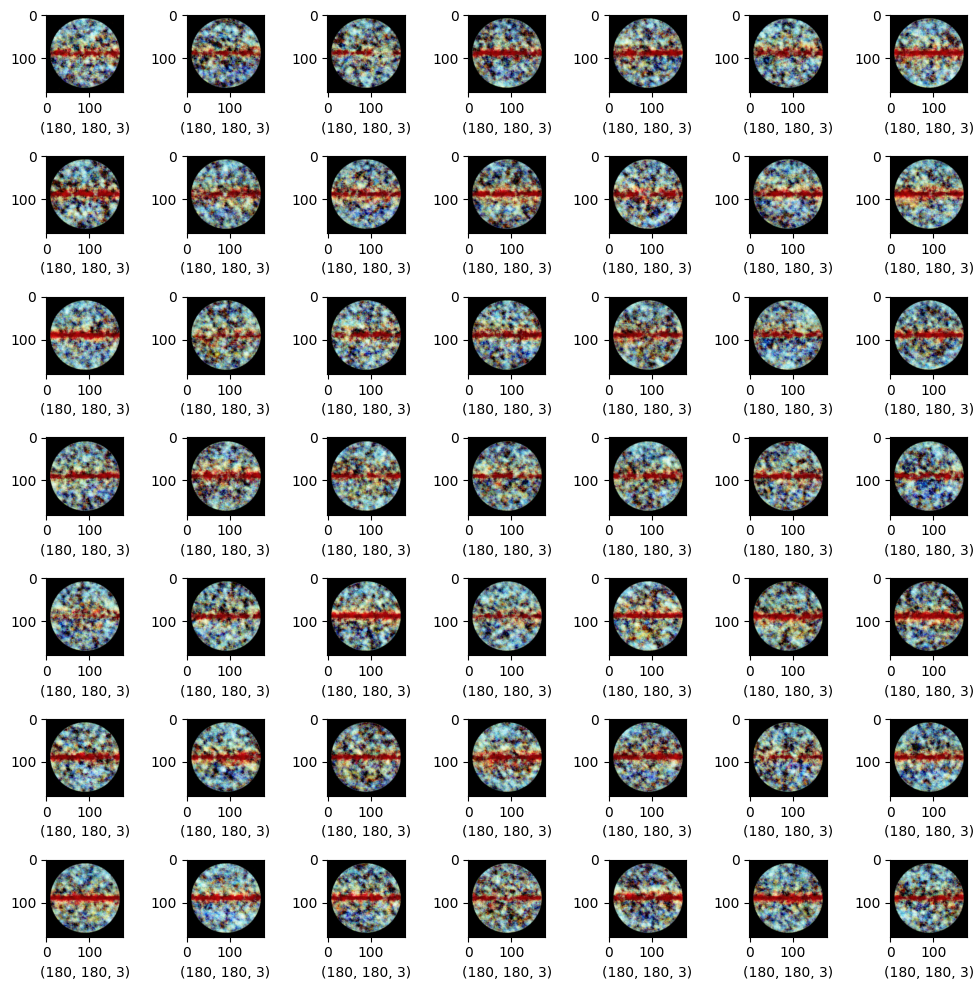

In [ ]:
figure, axes = plt.subplots(nrows=7,ncols=7,figsize=(10,10))

for i,ax in enumerate(axes.flat):
    IMG_Prediction_Output = Generator_Predict[i]
    ax.imshow(IMG_Prediction_Output)
    ax.set_xlabel(Generator_Predict[i].shape)
plt.tight_layout()
plt.show()

Este bloque crea una cuadrícula de 3x3 (9 subgráficos) para visualizar las primeras 9 imágenes de Generator_Predict. Itera sobre los ejes, muestra cada imagen con imshow, etiqueta el eje X con la forma de la imagen (e.g., (180, 180, 3)), ajusta el diseño con tight_layout, y muestra la figura, permitiendo evaluar los mapas sintéticos del fondo cósmico de microondas (CMB).

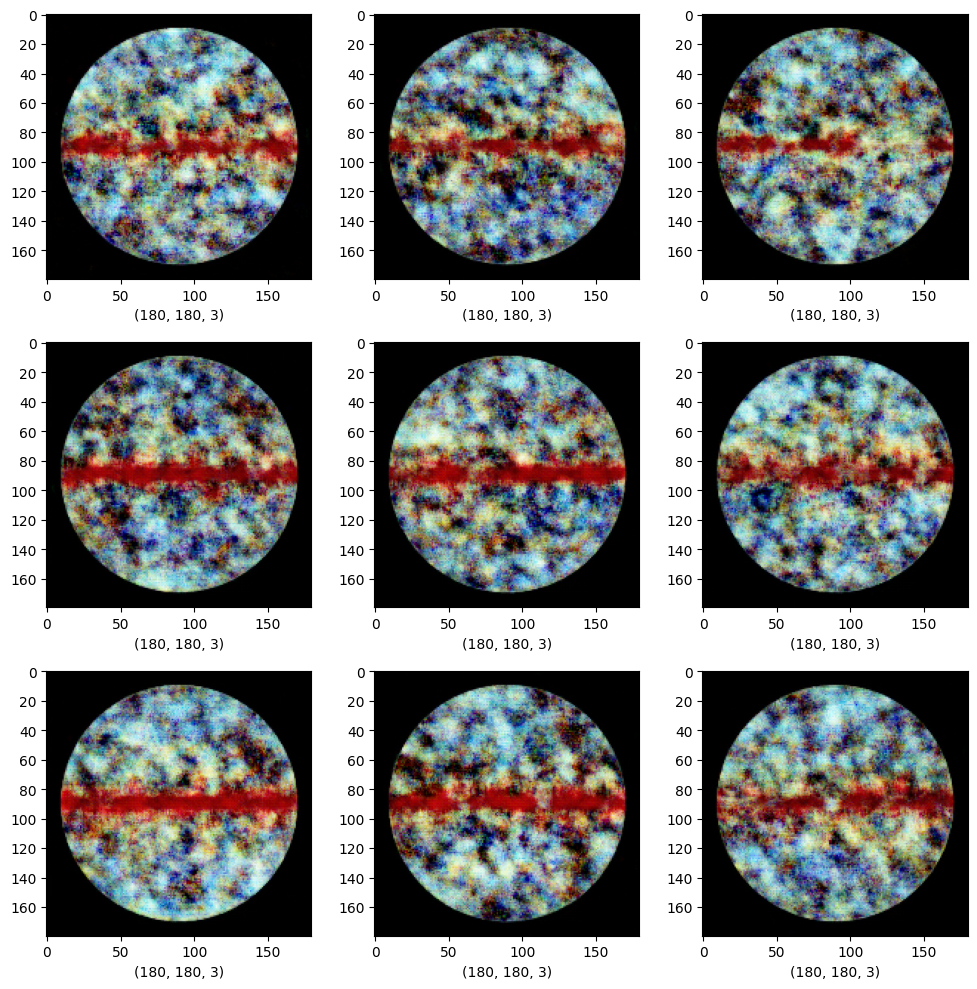

In [ ]:
figure, axes = plt.subplots(nrows=3,ncols=3,figsize=(10,10))

for i,ax in enumerate(axes.flat):
    IMG_Prediction_Output = Generator_Predict[i]
    ax.imshow(IMG_Prediction_Output)
    ax.set_xlabel(Generator_Predict[i].shape)
plt.tight_layout()
plt.show()

Este bloque crea una figura de 8x8 pulgadas, desactiva los ejes con axis("off"), muestra la imagen en el índice 25 de Generator_Predict (un mapa sintético del fondo cósmico de microondas) usando imshow, y la muestra. Sirve para inspeccionar visualmente una imagen específica generada por la DCGAN.

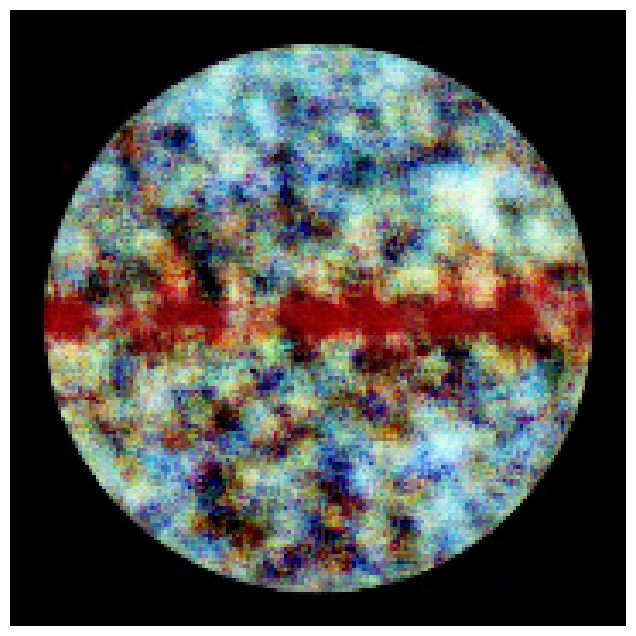

In [ ]:
figure = plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(Generator_Predict[25])
plt.show()

Crea una figura de 8x8, desactiva los ejes, muestra el mapa sintético del fondo cósmico de microondas en el índice 10 de Generator_Predict, y lo exhibe para inspección visual.

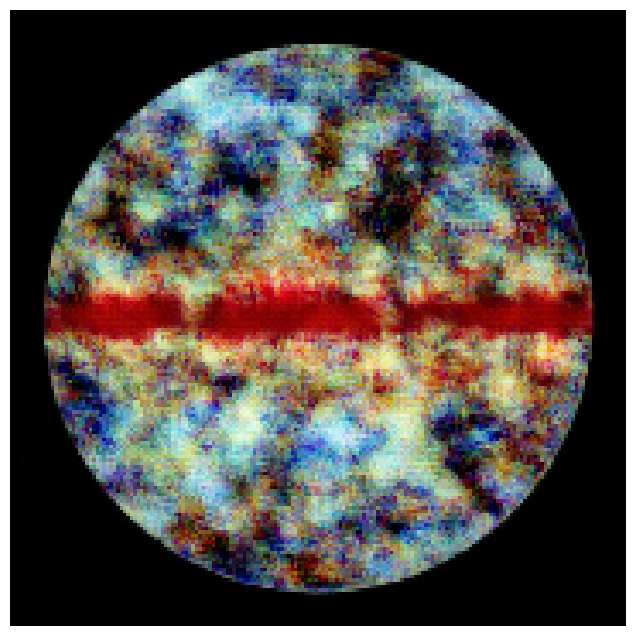

In [ ]:
figure = plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(Generator_Predict[10])
plt.show()

Crea una figura de 8x8, desactiva los ejes, muestra el mapa sintético del fondo cósmico de microondas en el índice 1 de Generator_Predict, y lo exhibe para inspección visual.

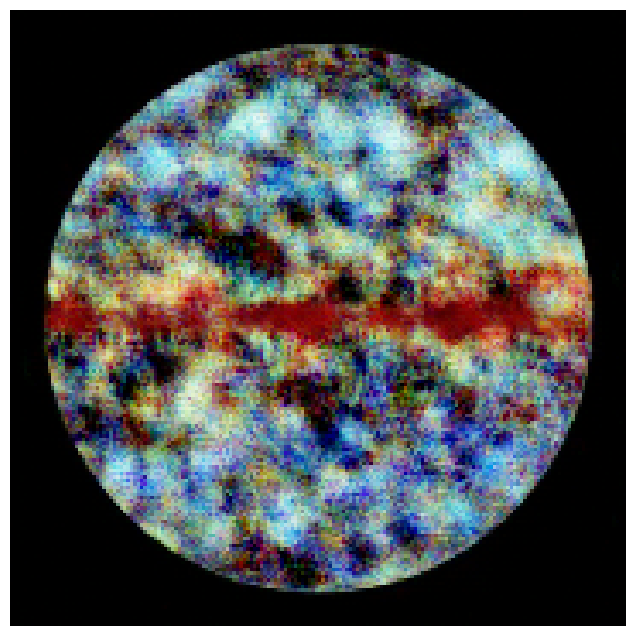

In [ ]:
figure = plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(Generator_Predict[1])
plt.show()

Crea una figura de 8x8, desactiva los ejes, muestra el mapa sintético del fondo cósmico de microondas en el índice 49 de Generator_Predict, y lo exhibe para inspección visual.

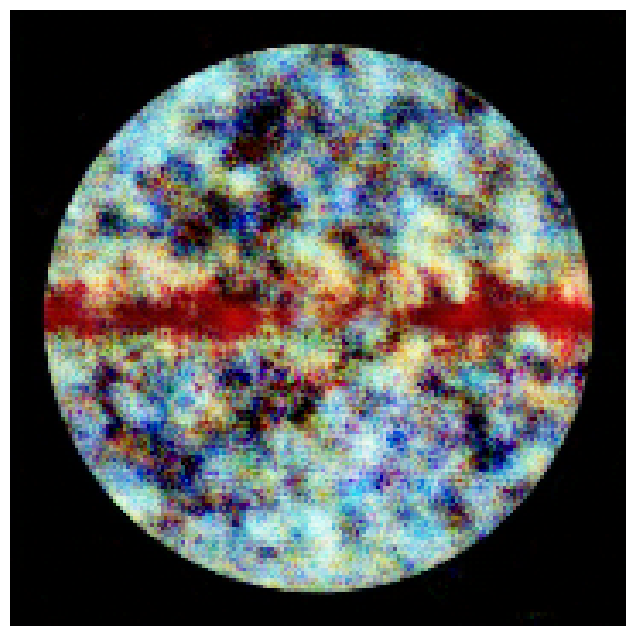

In [ ]:
figure = plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(Generator_Predict[49])
plt.show()

Crea una figura de 8x8, desactiva los ejes, muestra el mapa sintético del fondo cósmico de microondas en el índice 45 de Generator_Predict, y lo exhibe para inspección visual.

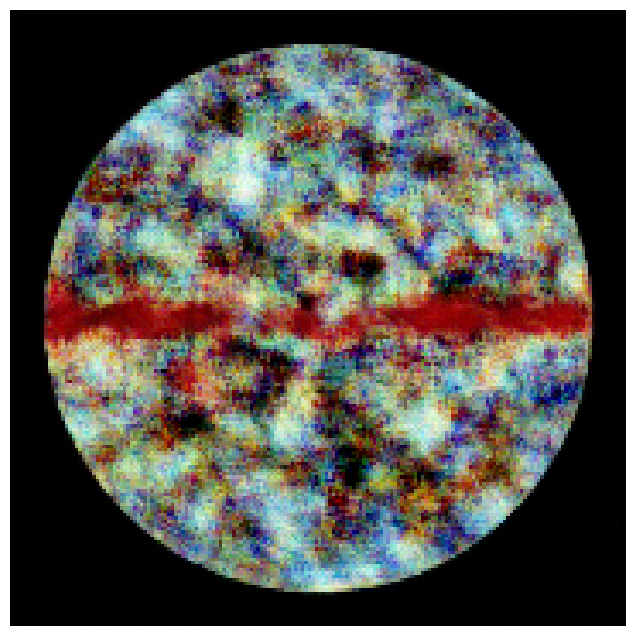

In [ ]:
figure = plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(Generator_Predict[45])
plt.show()

Crea una figura de 8x8, desactiva los ejes, muestra el mapa sintético del fondo cósmico de microondas en el índice 33 de Generator_Predict, y lo exhibe para inspección visual.

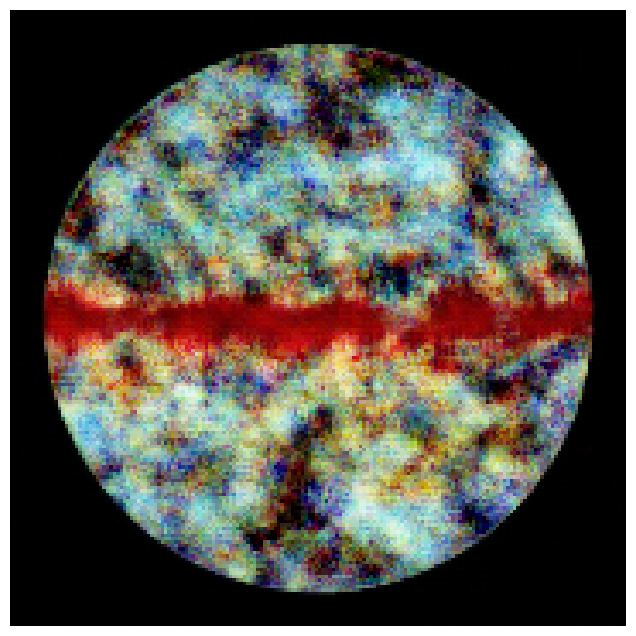

In [ ]:
figure = plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(Generator_Predict[33])
plt.show()

Estos bloques repiten el mismo proceso, variando solo el índice de Generator_Predict (25,10, 1, 49, 45,33) para mostrar imágenes específicas generadas por la DCGAN. Sirven para examinar individualmente los mapas sintéticos del CMB.

# DETAILED REVIEW

#### DCGAN OUTPUT

Este bloque crea una figura de 10x10 pulgadas, extrae la imagen del índice 22 de Generator_Predict como Random_Pre_Image, la muestra con imshow usando interpolación bicúbica y el mapa de colores **'nipy_spectral'** para **destacar variaciones de temperatura**, y la exhibe. Sirve para revisar detalladamente un mapa sintético del CMB generado por la DCGAN.

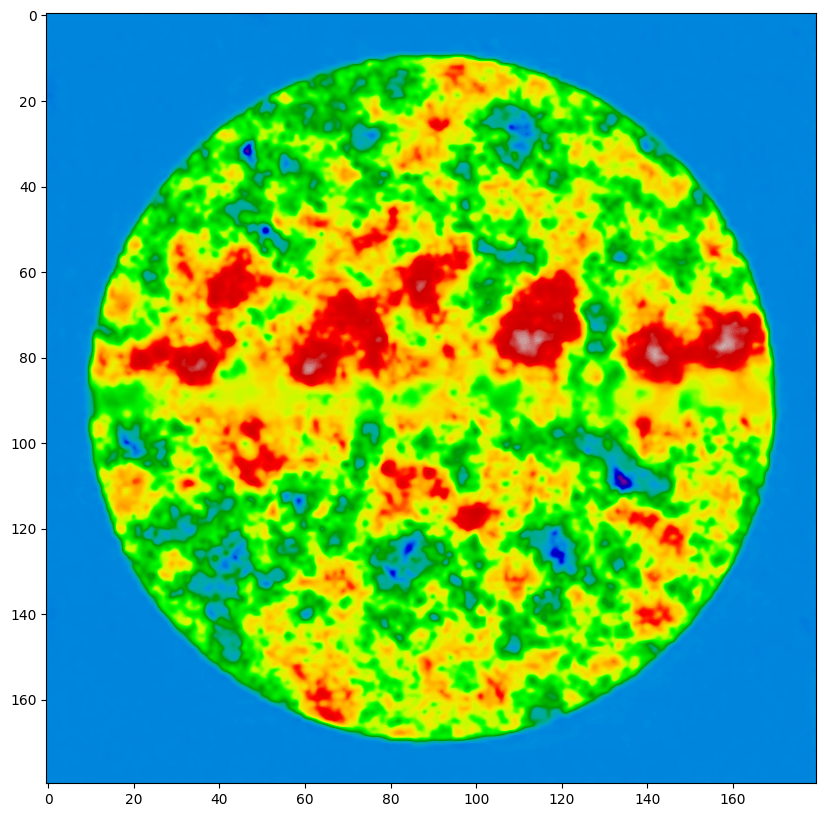

In [ ]:
figure = plt.figure(figsize=(10,10))

Random_Pre_Image = Generator_Predict[22]

plt.imshow(Random_Pre_Image[:,:,0],interpolation="bicubic").set_cmap('nipy_spectral')

Este bloque genera una cuadrícula de 3x3 (9 subgráficos) para visualizar las primeras 9 imágenes sintéticas generadas por el modelo DCGAN (Generator_Predict). Cada imagen es visualizada en escala de un solo canal (canal 0), utilizando un mapa de colores científicos (nipy_spectral) y una interpolación bicúbica para suavizar los bordes. Se incluye la forma de cada imagen como etiqueta en el eje X (por ejemplo, (180, 180, 3)). Finalmente, tight_layout() organiza los subgráficos para evitar solapamientos, permitiendo evaluar visualmente las estructuras generadas que simulan anisotropías del fondo cósmico de microondas (CMB).

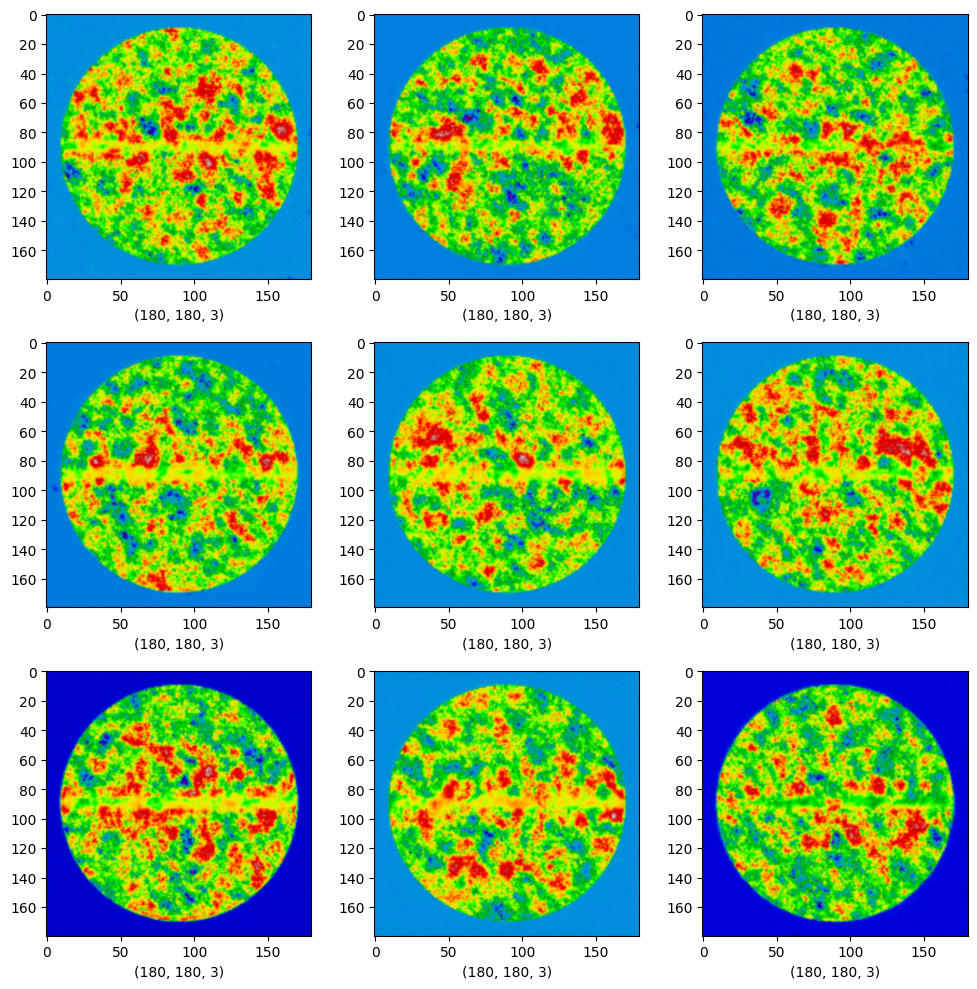

In [ ]:
figure, axes = plt.subplots(nrows=3,ncols=3,figsize=(10,10))

for i,ax in enumerate(axes.flat):
    IMG_Prediction_Output = Generator_Predict[i][:,:,0]
    ax.imshow(IMG_Prediction_Output,interpolation="bicubic").set_cmap('nipy_spectral')
    ax.set_xlabel(Generator_Predict[i].shape)
plt.tight_layout()
plt.show()

Este bloque genera una figura para visualizar una única imagen sintética del conjunto Generator_Predict, específicamente la imagen en la posición 42. Se selecciona únicamente el canal 0 (intensidad monocanal) de la imagen, y se visualiza utilizando interpolación bicúbica para suavizar la imagen y el mapa de color **'hot'**, que va de negro a rojo a amarillo, **enfatizando las zonas de mayor intensidad como si fueran regiones calientes**. Esta visualización permite resaltar estructuras similares a anisotropías térmicas dentro de un mapa simulado del fondo cósmico de microondas (CMB).

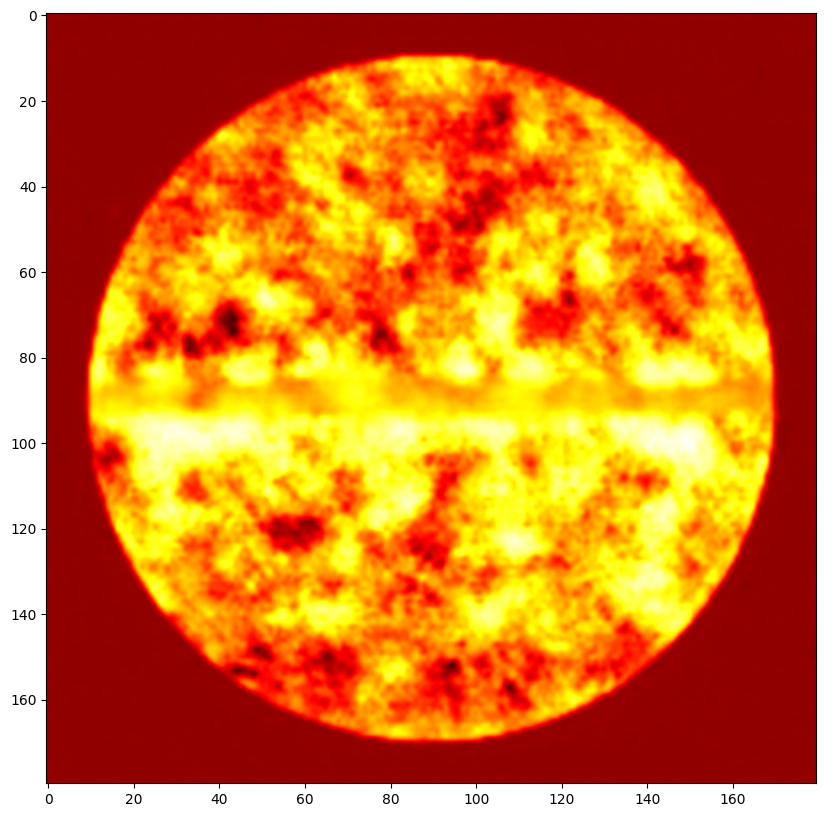

In [ ]:
figure = plt.figure(figsize=(10,10))

Random_Pre_Image = Generator_Predict[42]

plt.imshow(Random_Pre_Image[:,:,0],interpolation="bicubic").set_cmap('hot')

Este bloque crea una cuadrícula de 3x3 (9 subgráficos) para visualizar las primeras 9 imágenes generadas por el modelo Generator_Predict, mostrando únicamente el canal 0 (monocanal) de cada imagen. Cada una se representa usando el mapa de color 'hot', el cual varía de rojo oscuro a amarillo brillante, destacando gradientes de intensidad térmica. No se aplica interpolación adicional, y se etiqueta el eje X con la forma de la imagen (180, 180, 3). El diseño se ajusta con tight_layout() para evitar superposiciones, facilitando la inspección visual de las estructuras generadas del fondo cósmico de microondas (CMB).

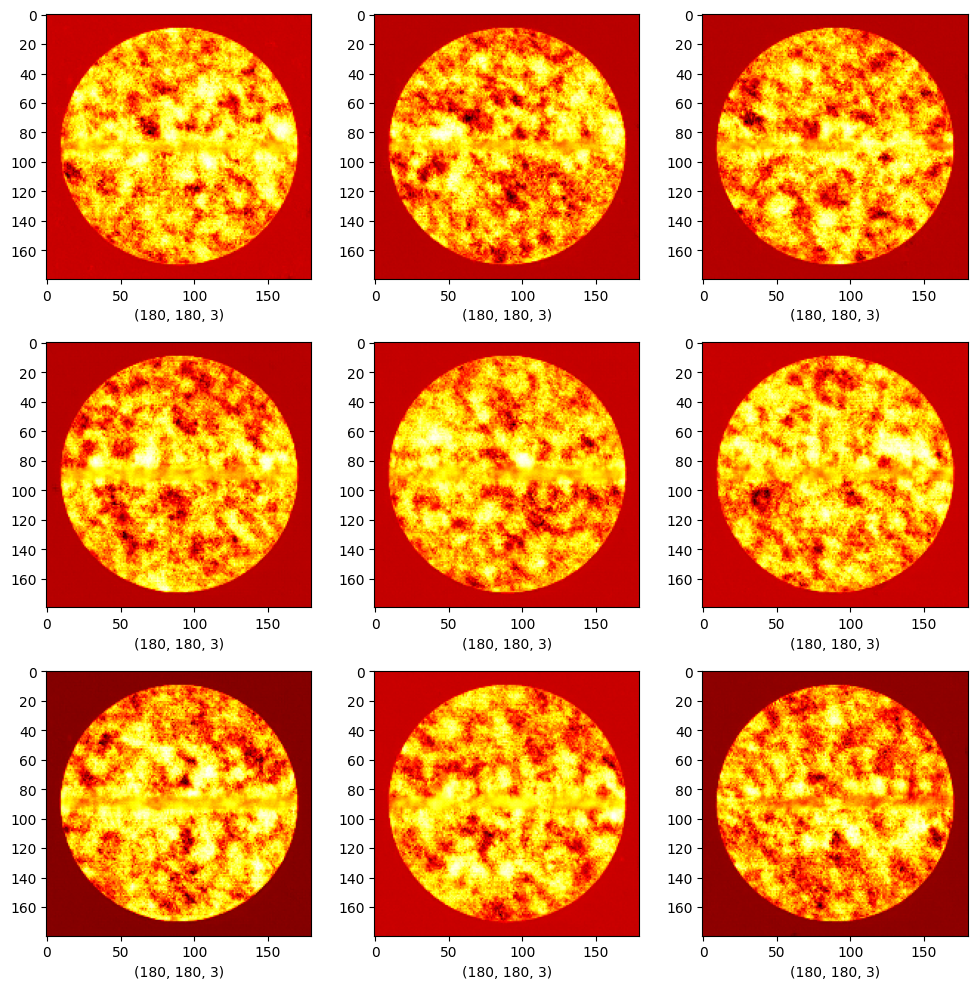

In [ ]:
figure, axes = plt.subplots(nrows=3,ncols=3,figsize=(10,10))

for i,ax in enumerate(axes.flat):
    IMG_Prediction_Output = Generator_Predict[i][:,:,0]
    ax.imshow(IMG_Prediction_Output).set_cmap('hot')
    ax.set_xlabel(Generator_Predict[i].shape)
plt.tight_layout()
plt.show()

##Histogramas

###1 de 6

Este bloque genera un histograma de color para una imagen generada (Generator_Predict[1]). La imagen es escalada a una escala de 0 a 255 (multiplicando por 255), simulando una imagen en formato estándar RGB. Se calcula y grafica el histograma de intensidad para cada canal de color (rojo, verde y azul), utilizando 256 bins que representan los posibles valores de color (0 a 255). El eje X muestra los valores de intensidad y el eje Y indica la cantidad de píxeles que poseen cada valor. Esto permite analizar la distribución total de la imagen generada y evaluar su variabilidad cromática, lo cual es útil para validar el realismo visual y balance de color del modelo generativo.


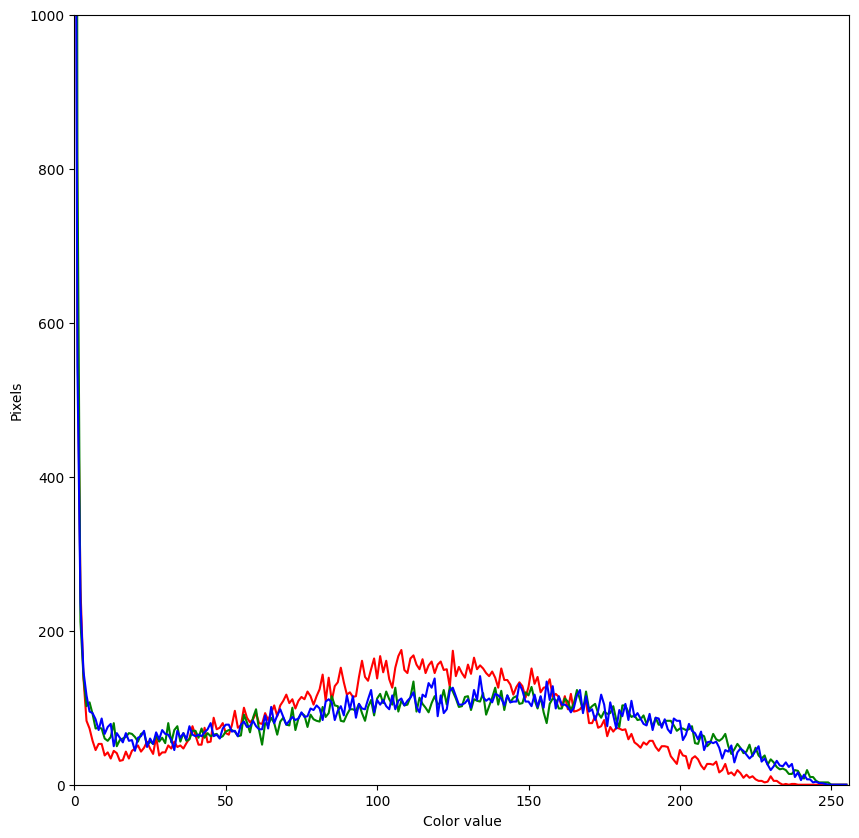

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Generator_Predict[1] * 255

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###2 de 6
Este bloque genera un histograma de color para la imagen generada número 12 (índice 12) (Generator_Predict[12]). La imagen es escalada al rango estándar de color (0–255) para simular una representación RGB convencional. Se calcula y grafica la distribución de intensidad para cada uno de los tres canales (rojo, verde y azul), empleando 256 bins que cubren el rango completo de valores posibles. El eje X muestra los valores de color y el eje Y representa el número de píxeles que contienen cada valor. Esta visualización permite inspeccionar el balance de color, la presencia de saturación o predominio de ciertas intensidades, y comparar la diversidad cromática generada por el modelo DCGAN.


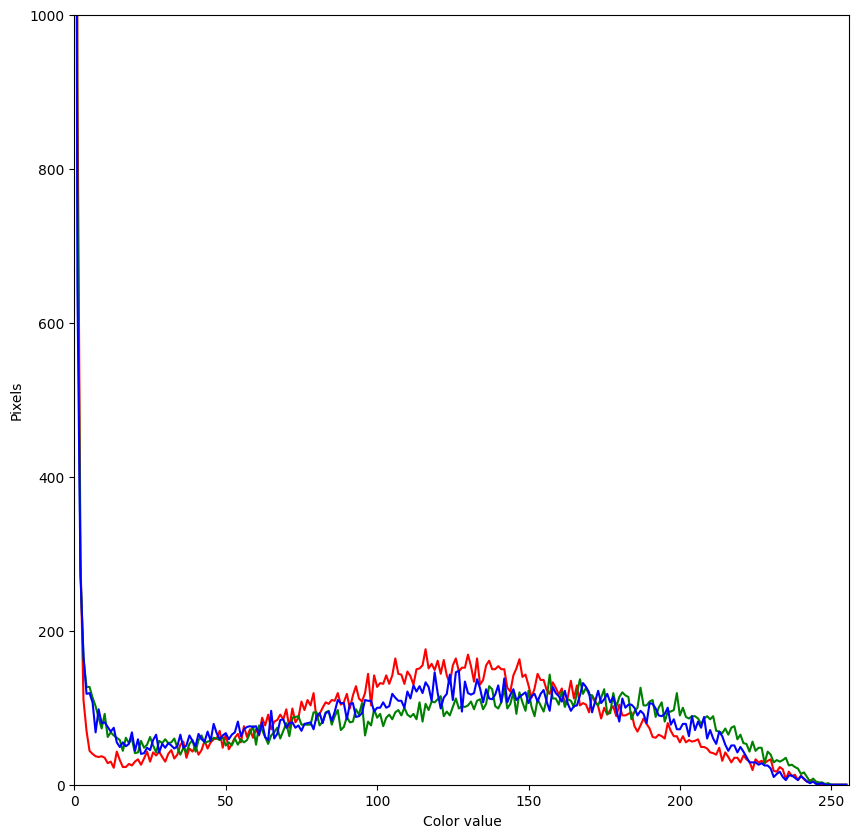

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Generator_Predict[12] * 255

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###3 de 6

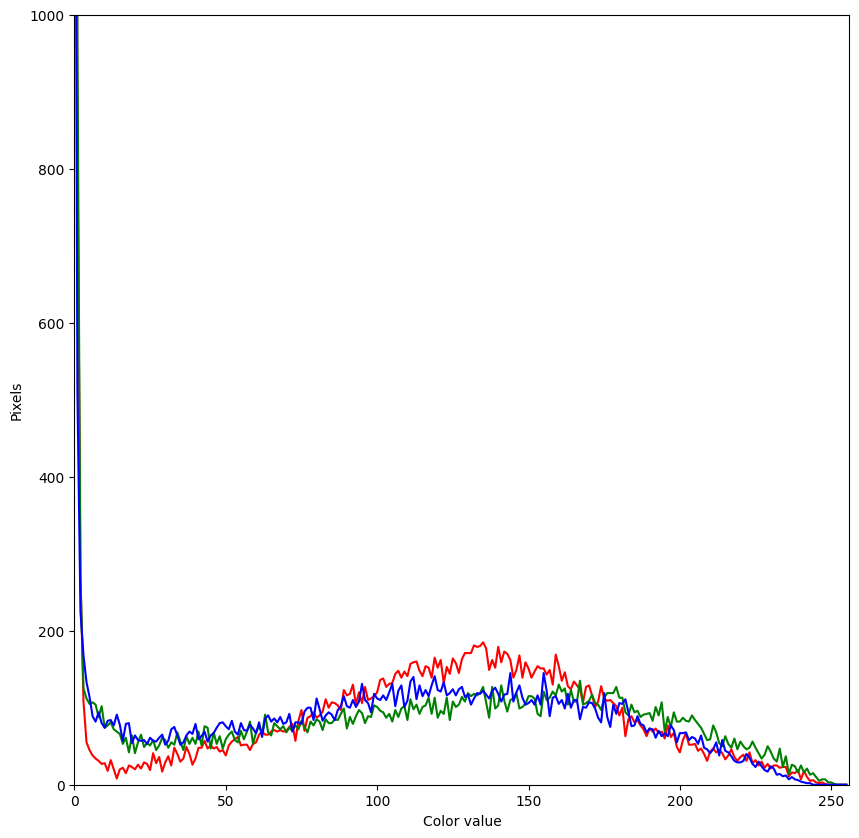

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Generator_Predict[22] * 255

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###4 de 6

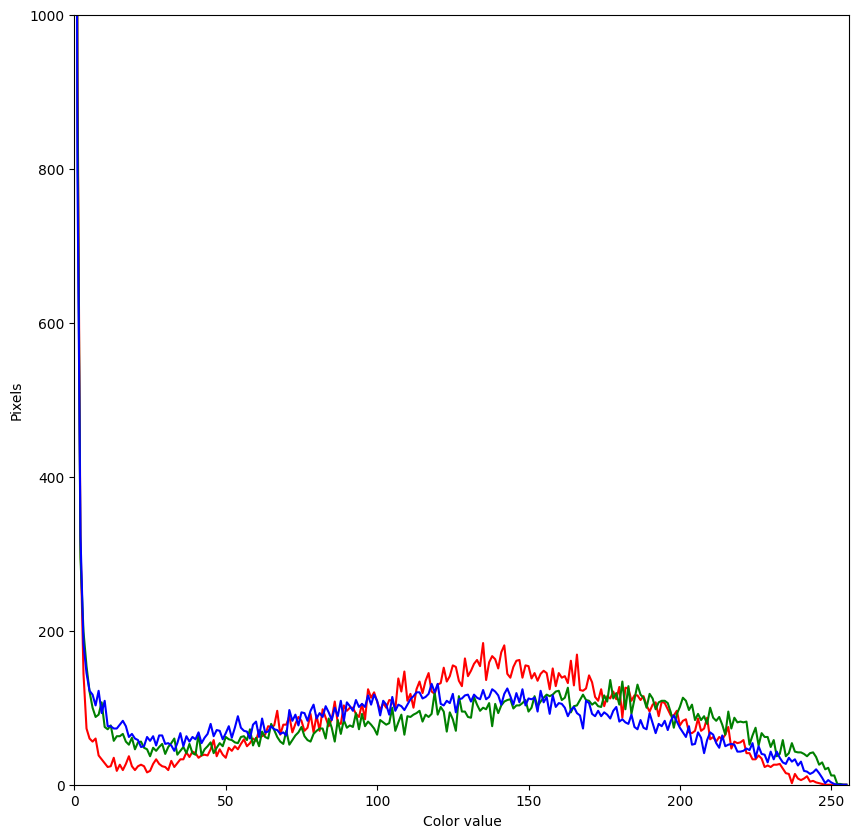

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Generator_Predict[32] * 255

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###5 de 6

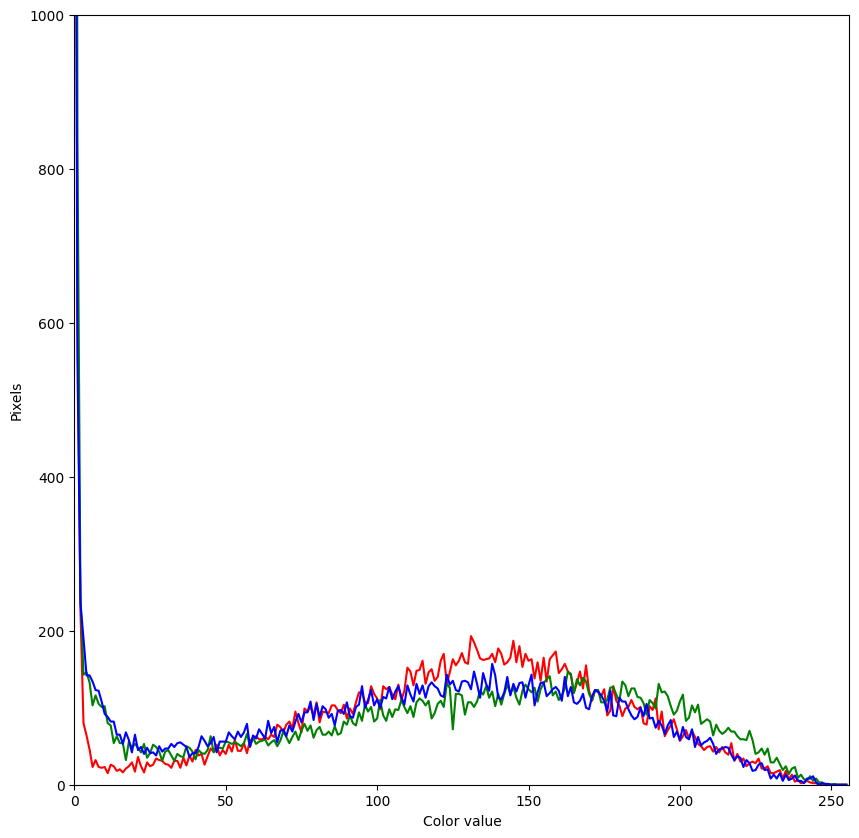

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Generator_Predict[42] * 255

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###6 de 6

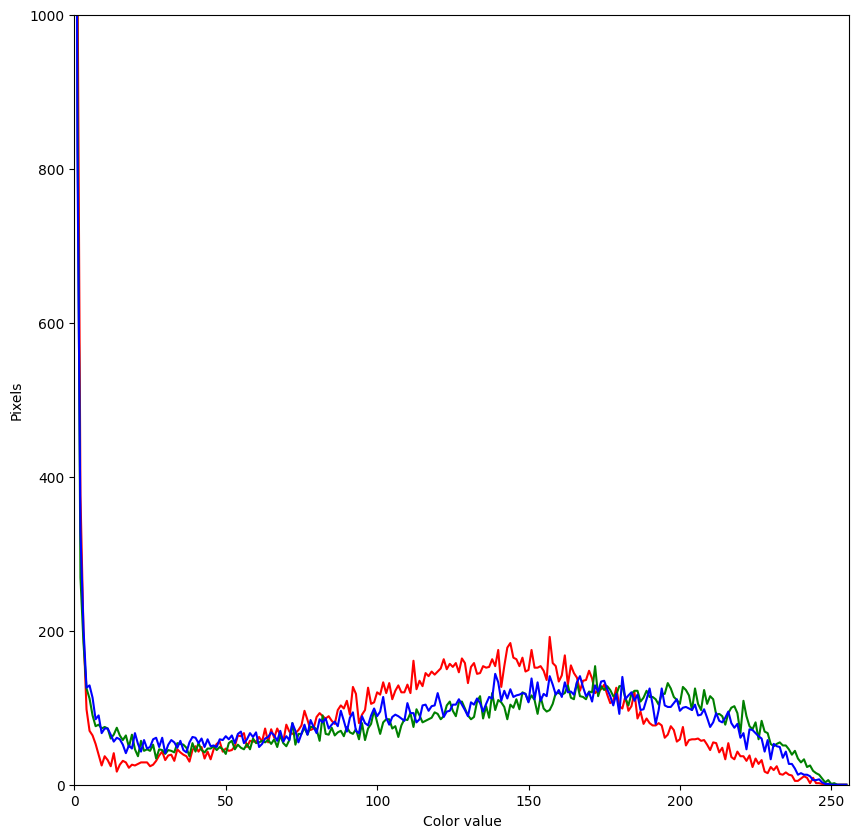

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Generator_Predict[49] * 255

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

Todos estos códigos son esencialmente el mismo análisis aplicado a distintas imágenes:

  * Bloque 1: imagen Generator_Predict[1]

  * Bloque 2: imagen Generator_Predict[12]

  * Bloque 3: imagen Generator_Predict[22]

  * Bloque 4: imagen Generator_Predict[32]

  * Bloque 5: imagen Generator_Predict[43]

  * Bloque final: imagen Generator_Predict[49]




Cada celda genera un histograma de color de una imagen específica generada por el modelo. La imagen se escala al rango de 0 a 255 para simular un formato RGB tradicional, y se calcula la distribución de intensidades para los canales rojo, verde y azul. El eje X representa los valores de color (0–255), y el eje Y indica el número de píxeles con ese valor. Este análisis permite evaluar la variabilidad cromática de las imágenes generadas y comparar la composición de color entre diferentes muestras sintéticas del fondo cósmico de microondas.

#### ORIGINAL OUTPUT:📚

###1 de 4 Descripción general al final




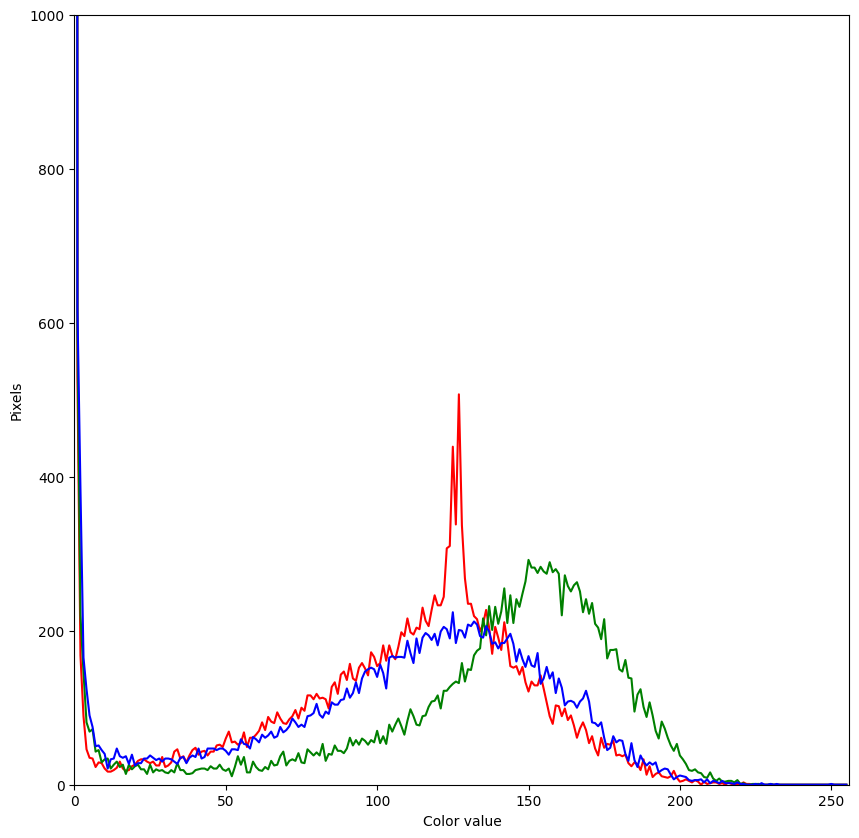

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Video_IMG_List[12]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###2 de 4 Descripción general al final

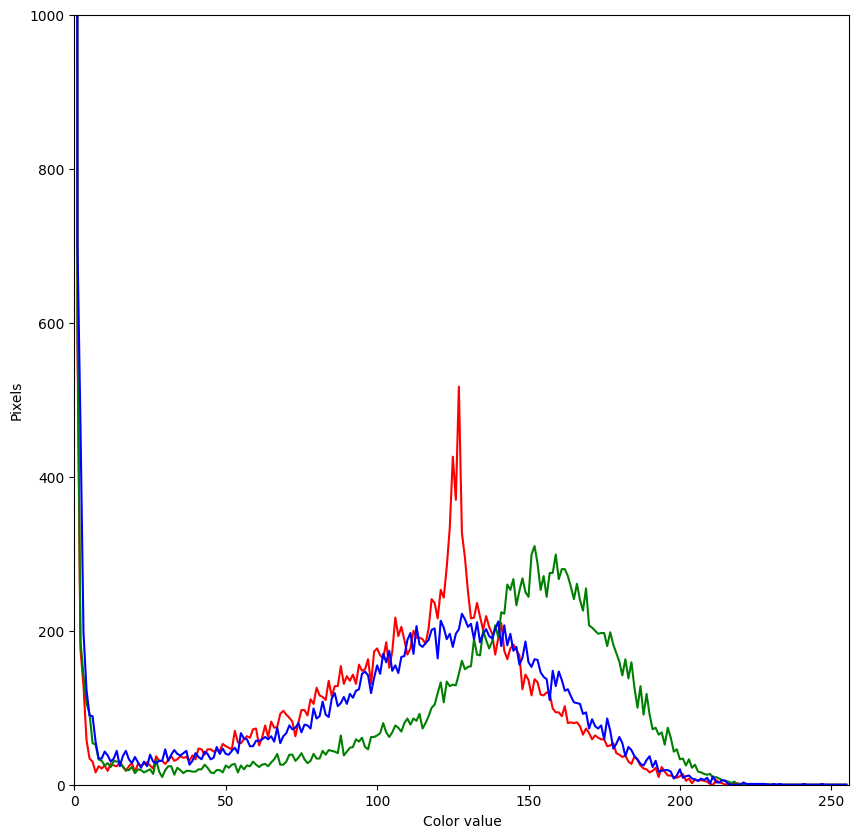

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Video_IMG_List[20]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###3 de 4 Descripción general al final

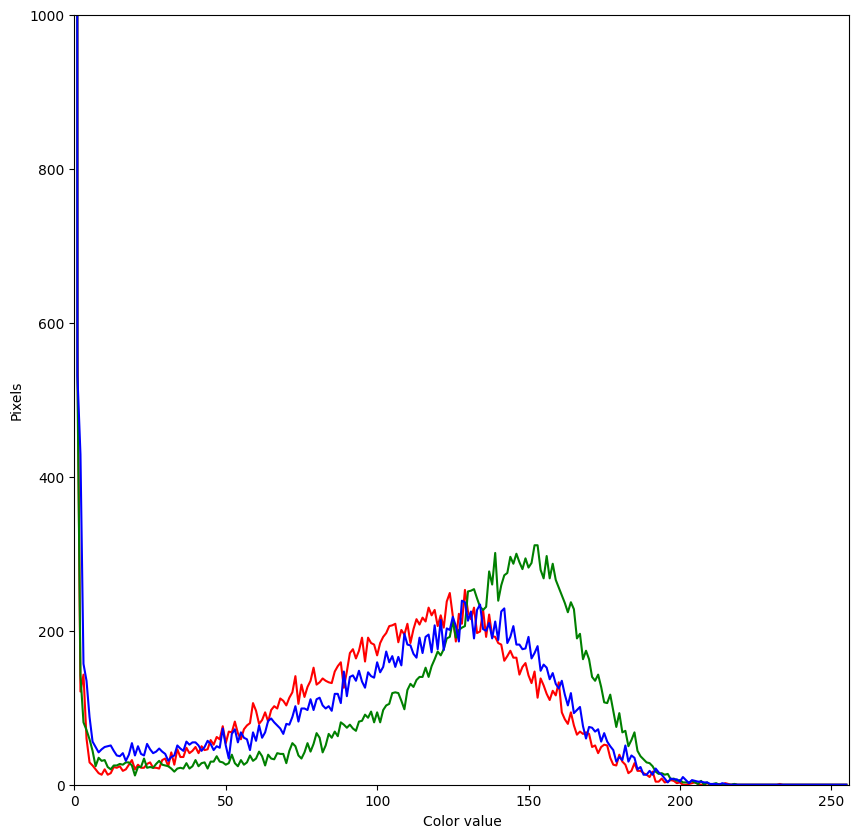

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Video_IMG_List[300]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###4 de 4 Descripción general al final

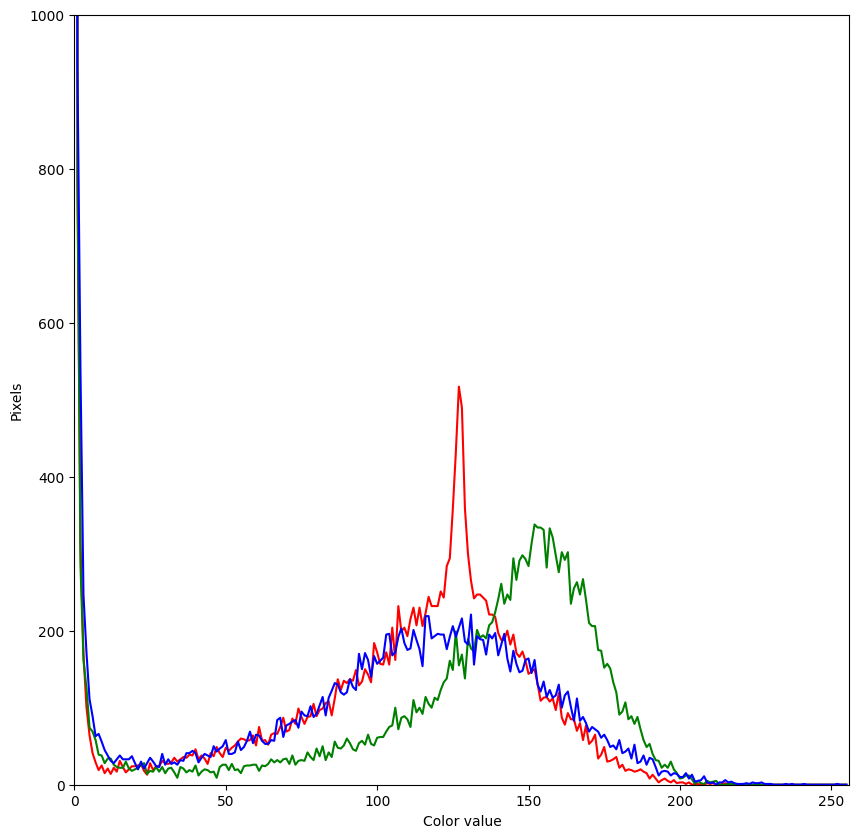

In [ ]:
figure = plt.figure(figsize=(10,10))

Picking_Image = Video_IMG_List[800]

colors = ("red", "green", "blue")
channel_dim = (0, 1, 2)

plt.xlim([0, 256])
plt.ylim([0, 1000])

for channel_id, c in zip(channel_dim, colors):
    histogram, bin_edges = np.histogram(
        Picking_Image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.xlabel("Color value")
plt.ylabel("Pixels")

plt.show()

###Descripción general de estos bloques (ORIGINAL OUTPUT)

Cada uno de estos bloques genera un histograma de color para una imagen real del conjunto Video_IMG_List, que contiene fotogramas extraídos del video del fondo cósmico de microondas (CMB). Se selecciona una imagen específica por índice (12, 20, 300 y 800) y se calcula la distribución de intensidad para los tres canales RGB, utilizando 256 bins para cubrir el rango completo de valores (0–255). Este análisis permite inspeccionar las propiedades cromáticas de las imágenes reales y comparar su estructura tonal frente a las imágenes generadas por el modelo DCGAN.

###Diferencia respecto a bloques anteriores
En lugar de Generator_Predict[i], se usa Video_IMG_List[i].
Estás evaluando datos reales del CMB en lugar de imágenes sintéticas.


**2. Espectro de potencias [1]:**

Es una forma de analizar cuánta variación (o energía) hay en el mapa a diferentes escalas angulares (tamaños de estructuras en el cielo).

 * Se calcula aplicando una transformada de Fourier 2D al mapa.

 * Cada frecuencia espacial representa estructuras de diferente tamaño (grandes escalas ↔ bajas frecuencias, pequeños detalles ↔ altas frecuencias).

 * En cosmología, el espectro de potencias real del CMB tiene una forma muy específica (picos acústicos), resultado de la física del universo temprano.

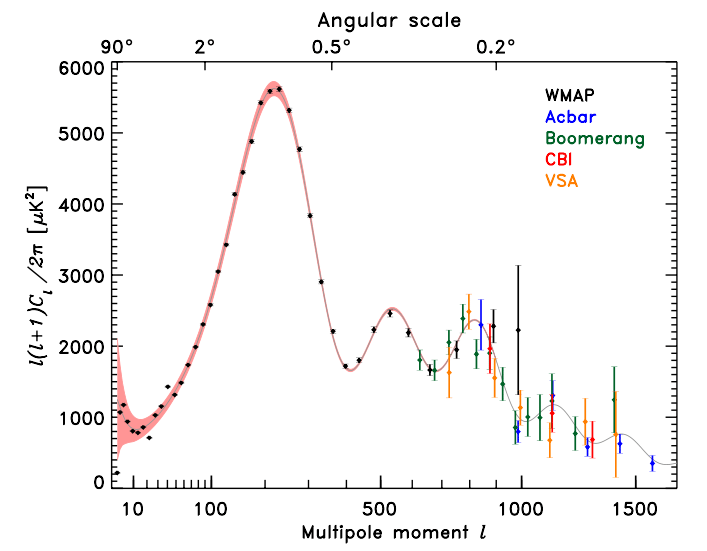

Esta gráfica muestra cómo varía la potencia de las fluctuaciones del CMB según el tamaño angular. Los picos representan oscilaciones del plasma en el universo temprano. El primer pico nos habla del tamaño del horizonte acústico, y su posición y forma permiten ajustar los parámetros cosmológicos. En el proyecto, si el espectro de potencias de las imágenes generadas se parece a este, eso indicaría que el modelo está capturando correctamente la física de las anisotropías térmicas del universo temprano.

**3. Prueba de gaussianidad: [2]**

Es una forma de verificar si la distribución de temperatura o intensidad en el mapa sigue una distribución normal (gaussiana), como se espera teóricamente para el CMB primitivo.

 * El CMB real se considera una realización de un campo gaussiano aleatorio.

 * Puedes hacer esta prueba usando un histograma de valores de píxeles (por canal o global) y comparar con una campana de Gauss.

 * También puedes aplicar pruebas estadísticas como:

   -Shapiro-Wilk [3]

   -Anderson-Darling [4]

   -Kolmogorov-Smirnov [5]

**4. Posibles mejoras para evaluar las predicciones de la DCGAN**

- **Escala de grises en lugar de RGB:** Hicimos este análisis de BGR, se transformó a RGB, pero la sugerencia es no transformarle por la (escala de grises), si usamos un solo canal, se modificaria todo.

El CMB es un campo escalar de temperatura en el cielo, por lo que cada pixel contiene un único valor físico, no imppagenes en color. Usar imágenes en escala de grises (1 canal) refleja esta estructura correctamente. El uso de RGB introduce redundancia y podría hacer que la red aprenda patrones visuales arbitrarios que no tienen interpretación física

- **Normalización adecuada de las imágenes**
Para entrenar correctamente la red y facilitar la convergencia, se recomienda normalizar los valores de los píxeles al rango [-1, 1], en lugar de [0, 255] o [0, 1]. Y para visualizar imágenes generadas, se revierte la normalización.
Esto asegura compatibilidad con la activación tanh en la salida del generador y mejora la estabilidad del entrenamiento.

- **Métricas de calidad de imagen**
Más allá de la inspección visual, pueden aplicarse métricas como:

 * SSIM (Índice de Similitud Estructural)

 * MSE (Error Cuadrático Medio)

 * PSNR (Relación Pico-Señal/Ruido)

Para comparar cuantitativamente las imágenes generadas respecto a las reales.

- **Tests estadísticos (gaussianidad) y físicos (espectro de potencias).**


**REFERENCIAS**

[1] González González, M. (2014). Análisis de la normalidad en datos estadísticos: Aplicación de las pruebas de Shapiro-Wilk, Anderson-Darling y Kolmogorov-Smirnov [Trabajo de fin de grado, Universidad de Cantabria]. Repositorio UCrea. https://repositorio.unican.es/xmlui/handle/10902/5947

[2] Luzuriaga Jaramillo, H. A., Espinosa Pinos, C. A., Haro Sarango, A. F., & Ortiz Román, H. D. (2023). Histograma y distribución normal: Shapiro-Wilk y Kolmogorov-Smirnov aplicado en SPSS. LATAM Revista Latinoamericana de Ciencias Sociales y Humanidades, 4(4), 596–607. https://doi.org/10.56712/latam.v4i4.1242

[3] Malato, G. (2025, 23 de enero). An Introduction to the Shapiro-Wilk Test for Normality. Built In. https://builtin.com/data-science/shapiro-wilk-test

[4] National Institute of Standards and Technology (NIST). (n.d.). 1.3.5.14. Anderson-Darling Test. En Engineering Statistics Handbook. https://www.itl.nist.gov/div898/handbook/eda/section3/eda35e.htm

[5] National Institute of Standards and Technology (NIST). (n.d.). 1.3.5.16. Kolmogorov-Smirnov Goodness-of-Fit Test. En Engineering Statistics Handbook. https://www.itl.nist.gov/div898/handbook/eda/section3/eda35g.htm

- **Conclusión final**

En este proyecto se implementó y entrenó una Red Generativa Antagónica Convolucional (DCGAN) para generar mapas sintéticos del Fondo Cósmico de Microondas (CMB), con el objetivo de evaluar la capacidad de las redes neuronales para capturar patrones estadísticos del universo temprano. A partir de un conjunto de datos reales, se entrenó un generador para producir imágenes que imiten las características visuales y estadísticas de los mapas originales del CMB.

Durante el proceso se exploraron aspectos técnicos clave, como la arquitectura de la red, la función de pérdida, el entrenamiento adversarial y la evolución del desempeño del generador y discriminador a lo largo de las épocas. Se realizaron visualizaciones tanto de las imágenes generadas como de sus histogramas RGB para evaluar cualitativamente la similitud con los datos reales.

Aunque se lograron resultados prometedores en términos visuales, se identificaron limitaciones inherentes al enfoque actual. La validación física de las imágenes generadas sigue siendo un reto, y se propuso incorporar análisis como el espectro de potencias o pruebas de gaussianidad para evaluar con mayor rigor si las fluctuaciones generadas reproducen las propiedades del CMB real. Estas mejoras podrían orientar futuros desarrollos hacia una evaluación cuantitativa más precisa y físicamente significativa del desempeño del modelo.

En suma, este trabajo demuestra el potencial de las GANs en contextos cosmológicos, pero también resalta la importancia de combinar técnicas de aprendizaje profundo con herramientas del análisis físico y estadístico para garantizar la validez científica de los resultados generados.